# Analyse Rotation Spectra - Hourly PSDS - autoplots

## Load Libraries

In [1]:
from andbro__querrySeismoData import __querrySeismoData
from andbro__savefig import __savefig

from obspy import UTCDateTime
from scipy.signal import welch
from numpy import log10, zeros, pi, append, linspace, mean, median, array, where, transpose, shape, histogram, arange
from numpy import logspace, linspace, log, log10, isinf, ones, nan, count_nonzero, sqrt, isnan
from pandas import DataFrame, concat, Series, date_range, read_csv, read_pickle
from tqdm import tqdm_notebook
from pathlib import Path
from scipy.stats import median_absolute_deviation as mad

import os
import pickle
import matplotlib.pyplot as plt

In [2]:
def __get_minimal_psd(psds):

    from numpy import nanmin, array, nonzero
    
    min_psd = zeros(psds.shape[1])
    
    for f in range(psds.shape[1]):
        a = psds[:,f]
        min_psd[f] = nanmin(a[nonzero(a)])
    
    return min_psd

In [3]:
def __get_median_psd(psds):

    from numpy import median, zeros, isnan

    med_psd = zeros(psds.shape[1])

    for f in range(psds.shape[1]):
        a = psds[:,f]
        med_psd[f] = median(a[~isnan(a)])

    return med_psd

In [4]:
# def __get_minimum_psd(psds, f_tmp):
    
#     from numpy import median
    
#     f_before = f_tmp[0]
#     f_tmp[0] = 1e-9
    
#     for i, psd in enumerate(psds):
#         if i == 0: 
#             lowest_value = (psd/f_tmp).sum()
#             idx = 0

#         value = (psd/f_tmp).sum() 
        
#         if value < lowest_value and value != 0:
#             lowest_value = value
#             idx = i

#     f_tmp[0] = f_before      
    
#     return psds[idx]

In [5]:
def __get_minimum_psd(psds, f_tmp):
            
    for i, psd in enumerate(psds):
        if i == 0: 
            lowest_value = psd.sum()
            idx = 0

        value = psd.sum() 
        
        if value < lowest_value and value != 0:
            lowest_value = value
            idx = i   
    
    return psds[idx]

In [6]:
# def __get_lowest_rms(psds, f_tmp):
    
#     from numpy import median
    
#     for i, psd in enumerate(psds):
#         if i == 0: 
#             lowest_value = (psd/f_tmp).sum()
#             idx = 0

#         value = (psd/f_tmp).sum() 
        
#         if value < lowest_value and value != 0:
#             lowest_value = value
#             idx = i

#     f_tmp[0] = f_before      
    
#     return psds[idx]


In [7]:
def __get_array_from_dataframe(df):
    
    from pandas import to_numeric
    
    ## convert to list
    psds = []
    for col in array(df.columns):
        
        ## turn non-float series to float objects
        df[col] = to_numeric(df[col], errors = 'coerce')

        ## add to psds list
        psds.append(array(df[col]))

    return array(psds)

In [8]:
if os.uname().nodename == "lighthouse":
    root_path = "/home/andbro/kilauea-data/"
elif os.uname().nodename == "kilauea":
    root_path = "/import/kilauea-data/"

## Configurations

In [9]:
## ---------------------------------------

name = "PFO"
inname = "2022_PFO_Z_3600"
subdir = "PFO_2022_Z/"
threshold = 8e-10
period_limits = 1/50, 60


## ---------------------------------------

path = f"{root_path}BSPF/data/"

## load configurations
config = pickle.load(open(path+subdir+inname+"_config.pkl", 'rb'))

config['inname'] = inname
config['inpath'] = path+subdir
config['period_limits'] = period_limits
config['thres'] = threshold
config['station'] = name

config['outpath_figures'] = f"{root_path}/BSPF/figures_colorlines/"

config['frequency_limits'] = [1/config['period_limits'][1], 1/config['period_limits'][0]]

config['rlnm_model_path'] = f"{root_path}LNM/data/MODELS/"


## Methods

In [10]:
## theoretical rlnm
rlnm = read_csv(config['rlnm_model_path']+"rlnm_theory.csv")

In [11]:
def __filter_psds(psds, thresholds):
    
    from numpy import mean, array
    
    psds_filtered = []
        ## filter mean psds values
#         m_psd = mean(psd)
#         if m_psd > thresholds[0] and m_psd < thresholds[1]:
#             psds_filtered.append(psd)

    ## filter for periods larger than 20 seconds
    if mean(psd[0:63]) < thresholds[0]:
        psds_filtered.append(psd)

    print(f" -> removed {len(psds)- len(psds_filtered)} of {len(psds)} psds due to thresholds: {thresholds[0]} & {thresholds[1]}")
    return array(psds_filtered)

In [12]:
def __load_data_file(path, file):
    
    from tqdm.notebook import tqdm
    from numpy import array
    
    psds_all = []
    psds_hourly = read_pickle(path+file)
    
    for psd in psds_hourly:
        psds_all.append(psd)
        
    return array(psds_all)

In [13]:
def __cut_frequencies_array(arr, freqs, fmin, fmax):

    ind = []
    for i, f in enumerate(freqs):
        if f >= fmin and f <= fmax:
            ind.append(i)

    ff = freqs[ind[0]:ind[-1]]
    pp = arr[:,ind[0]:ind[-1]]
    
    return pp, ff 

In [14]:
def __remove_noisy_psds(arr, threshold_mean=1e-16):

    from numpy import delete, shape, sort, array
    
    l1 = shape(arr)[0]

    idx_to_remove = []
    rejected = []
    for ii in range(shape(arr)[0]):
        
        ## appy upper threshold
        if arr[ii,:].mean() > threshold_mean:
            rejected.append(arr[ii,:])
            idx_to_remove.append(ii)
            
        ## apply default lowe threshold
        if arr[ii,:].mean() < 1e-26:
            rejected.append(arr[ii,:])
            idx_to_remove.append(ii)
            
    for jj in sort(array(idx_to_remove))[::-1]:
        arr = delete(arr, jj, axis=0)  
        
    l2 = shape(arr)[0]
    
    print(f" -> removed {l1-l2} rows due to mean thresholds!")
    print(f" -> {l2} psds remain")
    
    return arr, rejected

In [15]:
def __makeplot_colorlines_overview(config, ff, psds, rejected, day):

    from tqdm.notebook import tqdm
    from numpy import isnan, median, mean, std, array, zeros
    from scipy.stats import median_abs_deviation as mad
    
#     psds_median = __get_median_psd(array(psds))
#     psds_minimal = __get_minimal_psd(array(psds))
#     psds_minimum = __get_minimum_psd(array(psds), ff)


    ## convert frequencies to periods
    pp=[]
    for mm in range(len(ff)):
        ppp = zeros(len(ff[mm]))
        ppp = 1/ff[mm]
        pp.append(ppp)
        
        
    ##____________________________
    
    NN = 3
    
    fig, axes = plt.subplots(NN,1, figsize=(10,10), sharey=False, sharex=True)

    plt.subplots_adjust(hspace=0.1)
    
    font = 14

#     N = max(psds[0].shape[0], psds[1].shape[0], psds[2].shape[0])
#     colors = plt.cm.rainbow(linspace(0, 1, N))

    N =24
    colors = plt.cm.rainbow(linspace(0,1,N))
    cmap = plt.get_cmap('rainbow', 24)
    
    
    ## add Frequency Axis
#     g = lambda x: 1/x
#     ax2 = axes[0].secondary_xaxis("top", functions=(g,g))
#     ax2.set_xlabel("  Frequency (Hz)", fontsize=font, labelpad=-1)
#     ax2.set_xticklabels(ff[2], fontsize=11)    
#     ax2.tick_params(axis='both', labelsize=font-2)
    
    
    for j in range(NN):
        for n, psd in enumerate(tqdm(psds[j])):
            axes[j].loglog(pp[j], psd, color=colors[n], alpha=0.7)
#             p2 = axes[j].scatter(pp[j][0], psd[0], s=0., c=n, cmap='rainbow', vmin=0, vmax=N)
            p2 = axes[j].scatter(pp[j][0], psd[0], s=0., c=n/N, cmap=cmap, vmin=0, vmax=N)
        
#         for reject in rejected[j]:
#              axes[j].loglog(pp[j],reject, color='grey', alpha=0.6, zorder=1)
                
#         axes[j].loglog(pp[j], __get_minimum_psd(psds[j], ff[j]), 'grey', zorder=3, alpha=0.9, label="Minimum")
        axes[j].loglog(pp[j], __get_median_psd(psds[j]), 'black', zorder=3, alpha=0.6, label="Median")
        
#         axes[j].loglog(rlnm['period'], rlnm['rlnm_psd_median'], color="black", zorder=2, ls="--", lw=2)
        
        axes[j].grid(True, which="both", ls="-", alpha=0.5)
        axes[j].legend(loc='lower left')
        axes[j].tick_params(labelsize=font-2)
        
#         axes[j].text(6, 2e-24, "RLNM", fontsize=font, rotation=-30)
        
#         xmin, xmax = config['period_limits'][0]-0.1*config['period_limits'][0], config['period_limits'][1]+0.05*config['period_limits'][1]
#         axes[j].set_xlim(xmin, xmax)
#         axes[j].set_ylim(bottom=8e-27)

#         axes[j].loglog([xmin, xmax], [config['thres'],config['thres']], color='grey')


        
    axes[NN-1].set_xlabel("  Period (s)", fontsize=font, labelpad=-1)

    ## panel labels
    axes[0].text(.01, .99, 'a)', ha='left', va='top', transform=axes[0].transAxes, fontsize=font+2)
    axes[1].text(.01, .99, 'b)', ha='left', va='top', transform=axes[1].transAxes, fontsize=font+2)
    axes[2].text(.01, .99, 'c)', ha='left', va='top', transform=axes[2].transAxes, fontsize=font+2)
    
    
    axes[0].set_ylabel(r"PSD$_{vertical}$ (m$^2$/s$^4$/$Hz)$", fontsize=font)
    axes[1].set_ylabel(r"PSD$_{north}$ (m$^2$/s$^4$/$Hz)$", fontsize=font)
    axes[2].set_ylabel(r"PSD$_{east}$ (m$^2$/s$^4$/$Hz)$", fontsize=font)
    
    ## set colorbar at bottom
    cbar = fig.colorbar(p2, orientation='vertical', ax=axes.ravel().tolist(), aspect=50, pad=-1e-5,
                       ticks=arange(1,N,2))


    plt.show(); 
    return fig

## RUN for all files 

2022_PFO_Z_3600_20221001_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


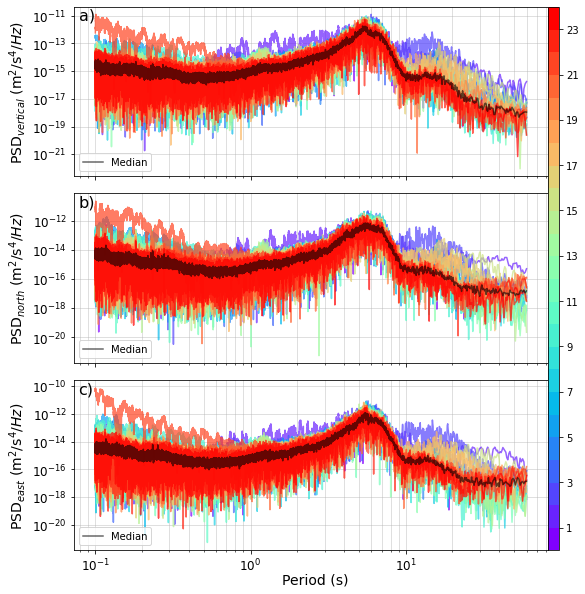


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221001.png ...

   -> Done

2022_PFO_Z_3600_20221002_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


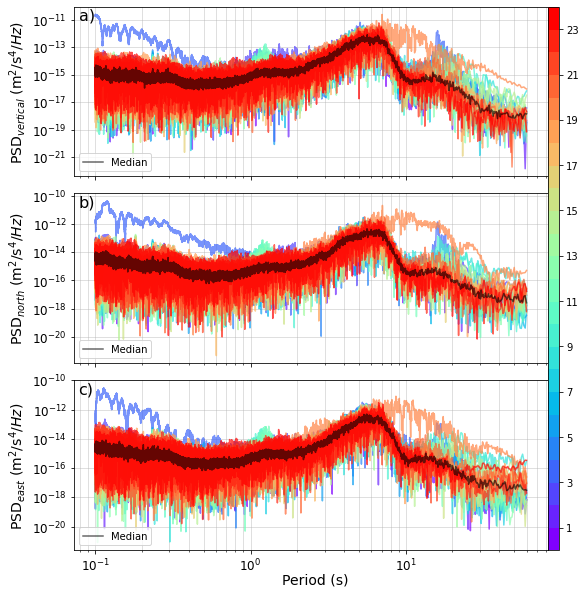


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221002.png ...

   -> Done

2022_PFO_Z_3600_20221003_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


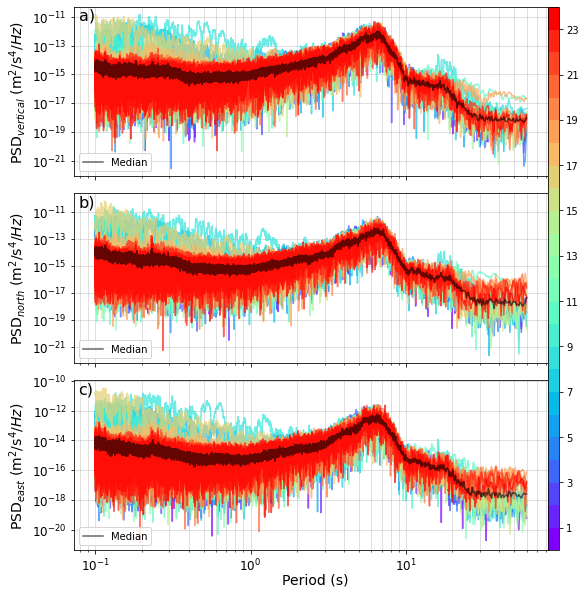


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221003.png ...

   -> Done

2022_PFO_Z_3600_20221004_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


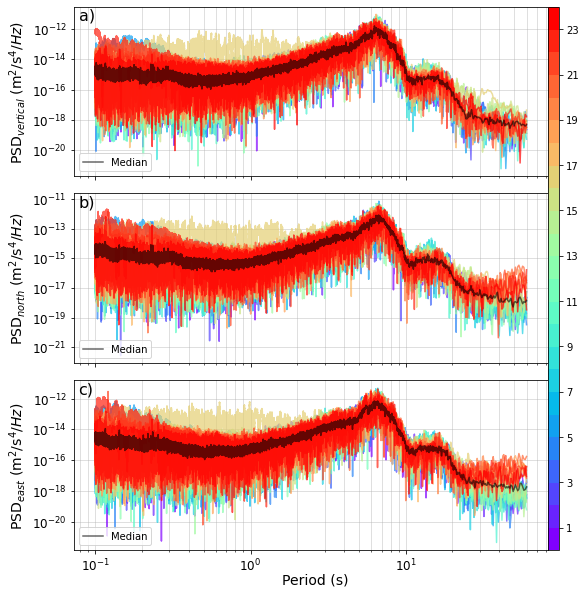


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221004.png ...

   -> Done

2022_PFO_Z_3600_20221005_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


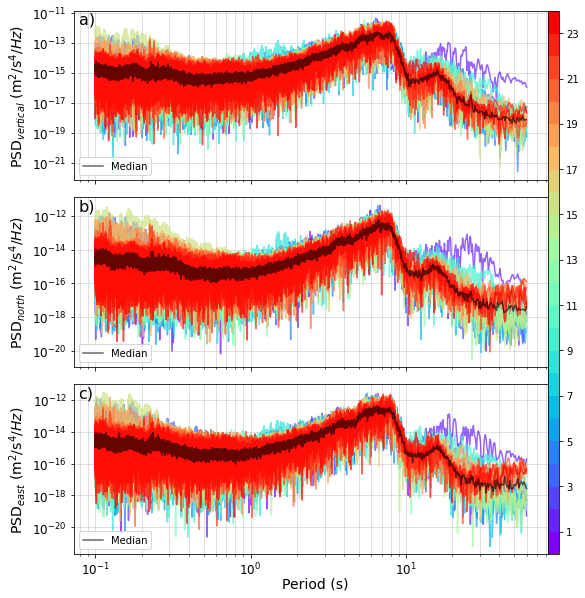


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221005.png ...

   -> Done

2022_PFO_Z_3600_20221006_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


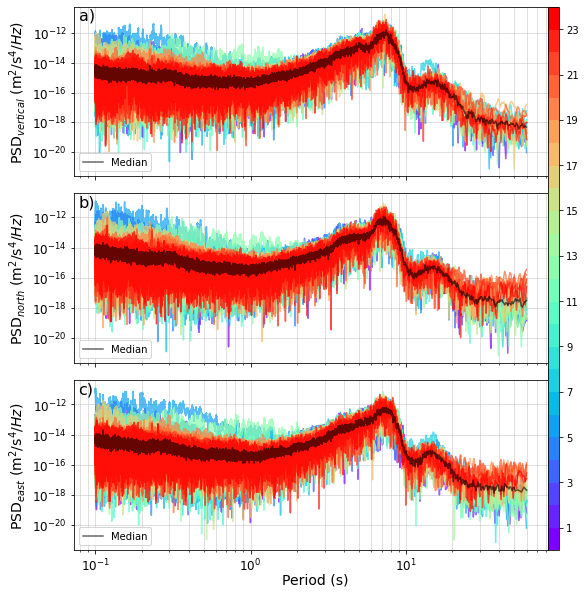


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221006.png ...

   -> Done

2022_PFO_Z_3600_20221007_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


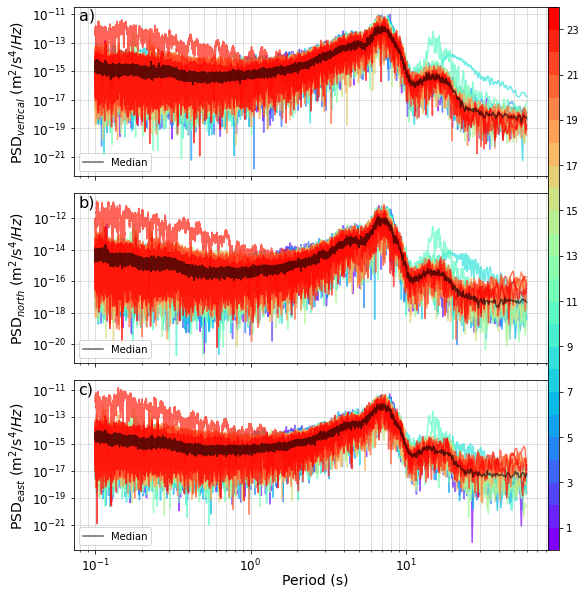


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221007.png ...

   -> Done

2022_PFO_Z_3600_20221008_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


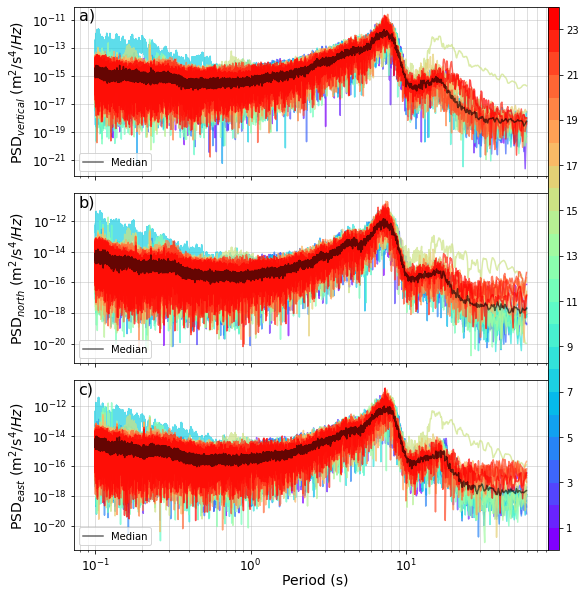


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221008.png ...

   -> Done

2022_PFO_Z_3600_20221009_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


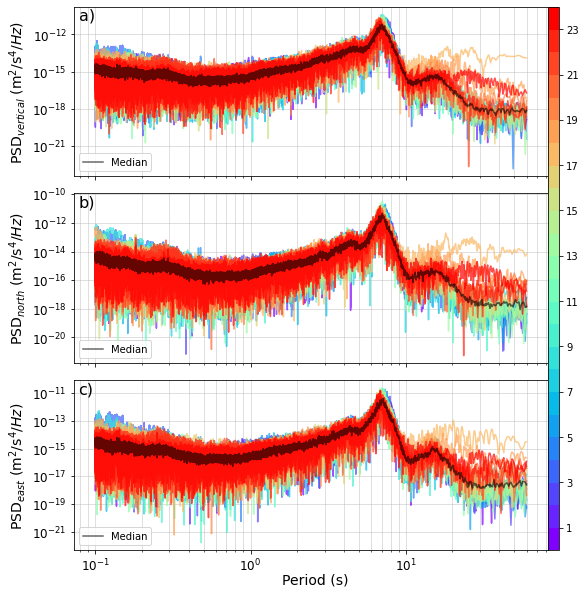


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221009.png ...

   -> Done

2022_PFO_Z_3600_20221010_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


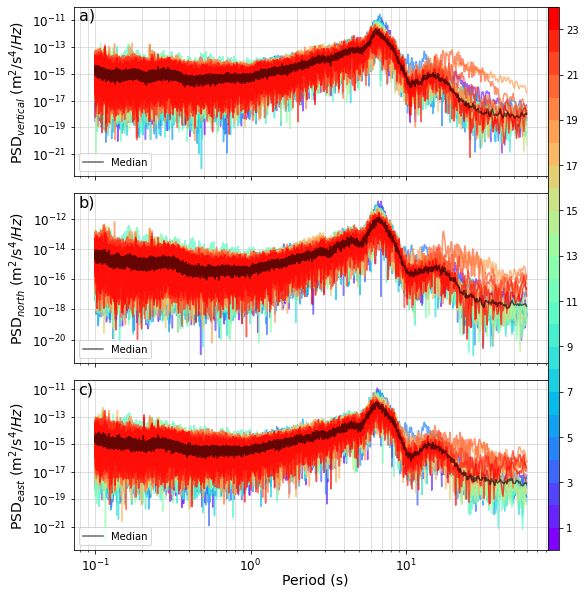


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221010.png ...

   -> Done

2022_PFO_Z_3600_20221011_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


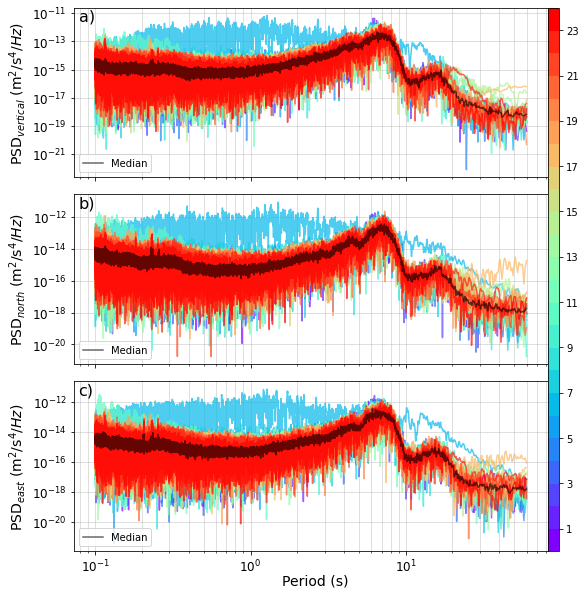


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221011.png ...

   -> Done

2022_PFO_Z_3600_20221012_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


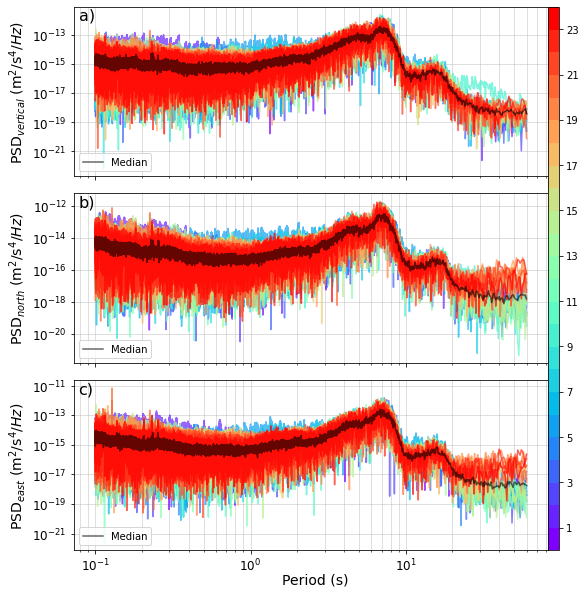


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221012.png ...

   -> Done

2022_PFO_Z_3600_20221013_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


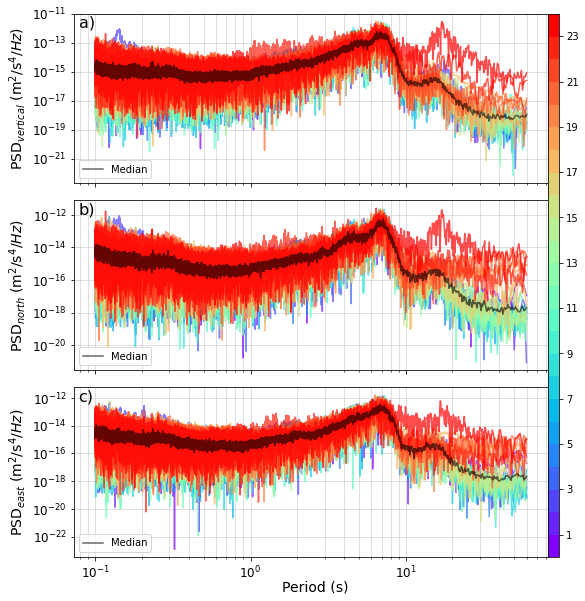


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221013.png ...

   -> Done

2022_PFO_Z_3600_20221014_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


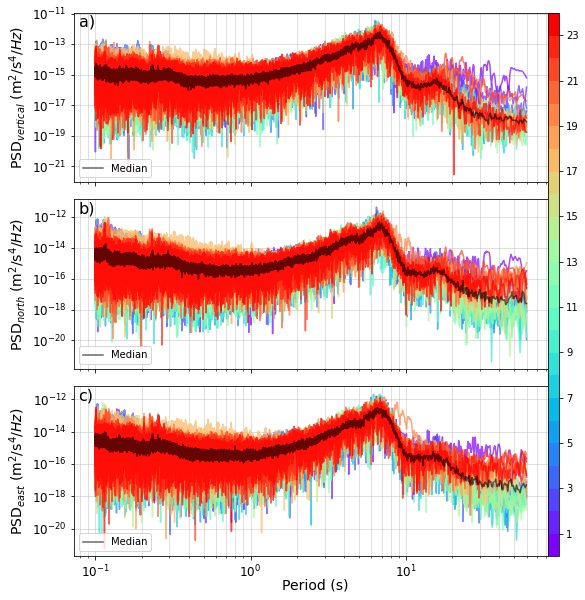


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221014.png ...

   -> Done

2022_PFO_Z_3600_20221015_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


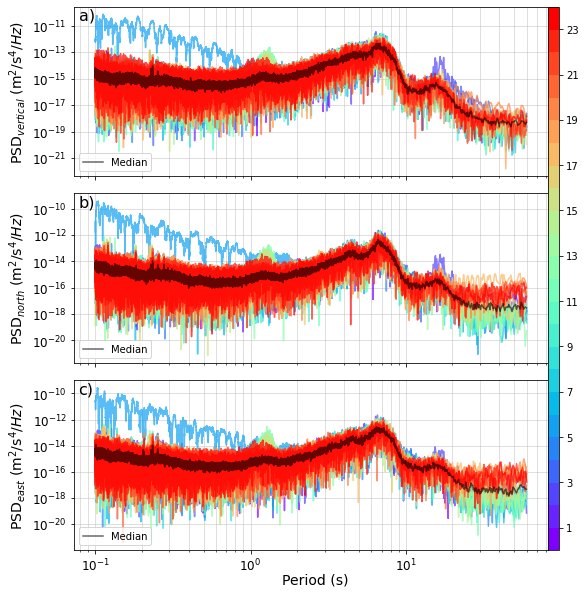


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221015.png ...

   -> Done

2022_PFO_Z_3600_20221016_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


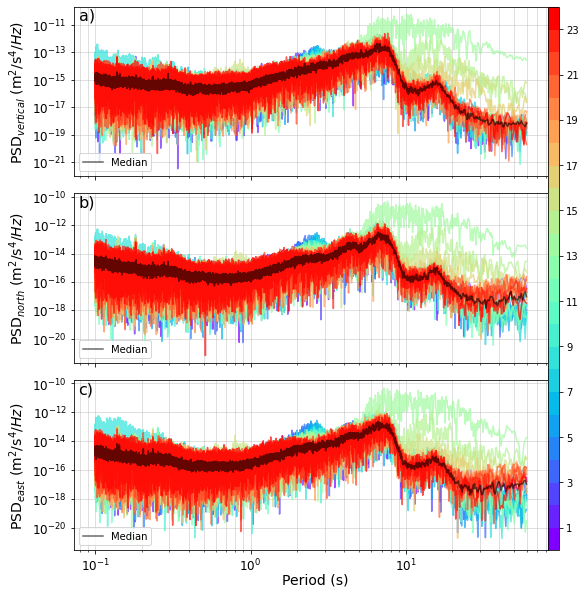


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221016.png ...

   -> Done

2022_PFO_Z_3600_20221017_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


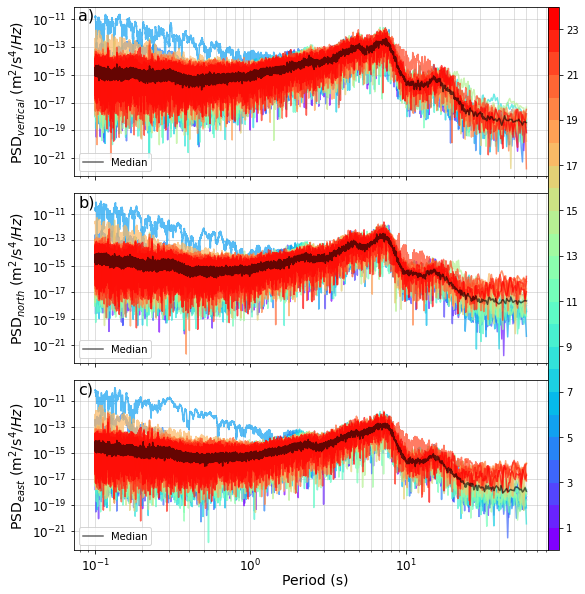


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221017.png ...

   -> Done

2022_PFO_Z_3600_20221018_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


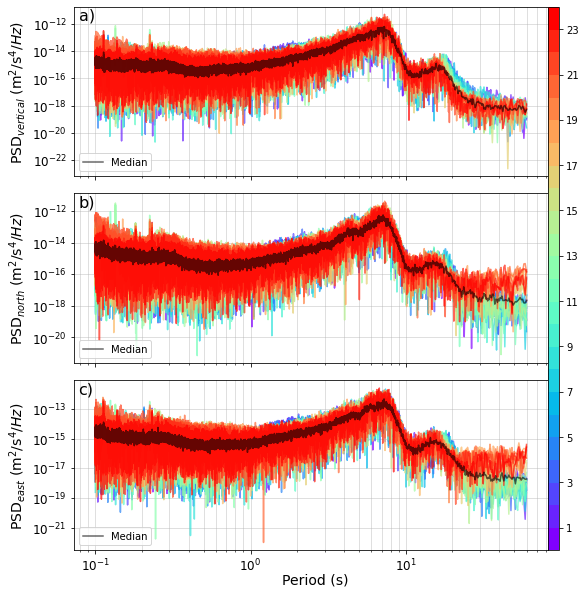


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221018.png ...

   -> Done

2022_PFO_Z_3600_20221019_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


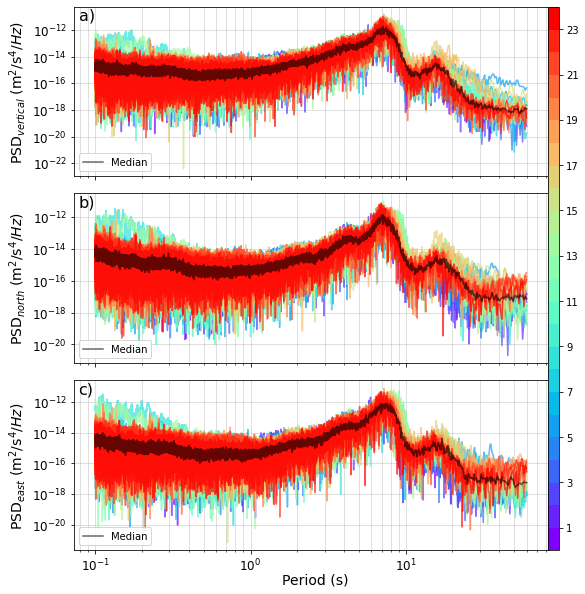


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221019.png ...

   -> Done

2022_PFO_Z_3600_20221020_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


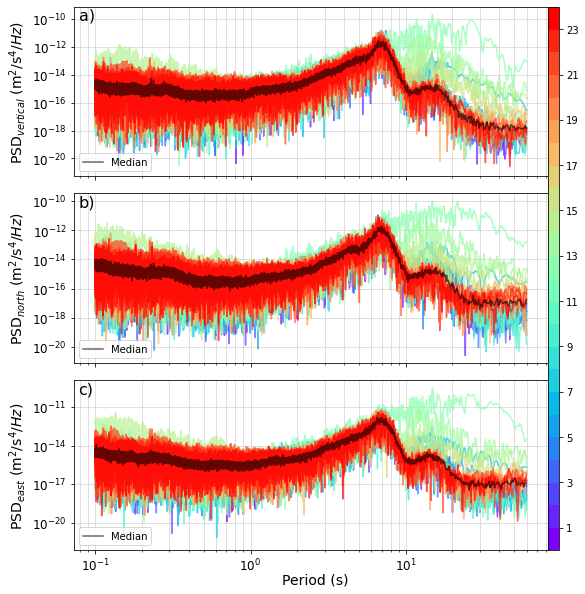


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221020.png ...

   -> Done

2022_PFO_Z_3600_20221021_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


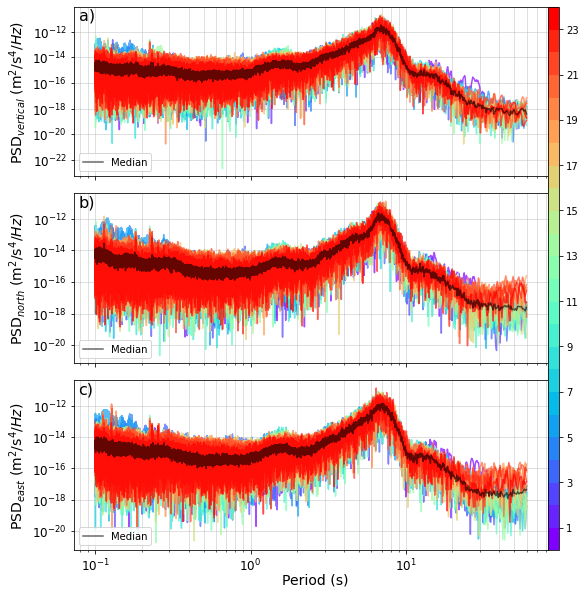


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221021.png ...

   -> Done

2022_PFO_Z_3600_20221022_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


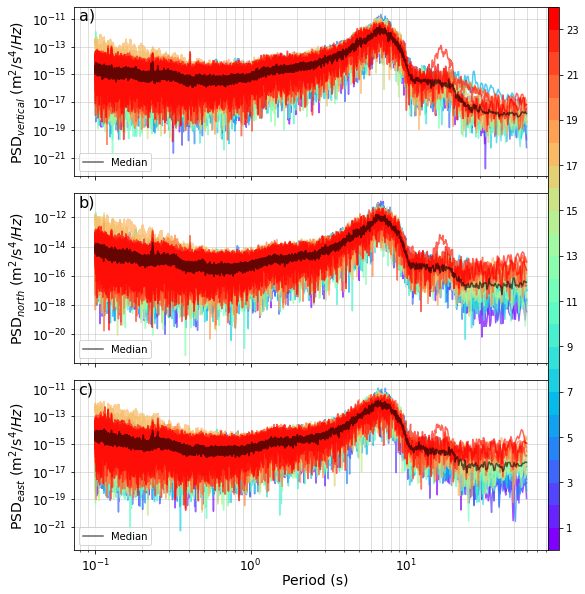


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221022.png ...

   -> Done

2022_PFO_Z_3600_20221023_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


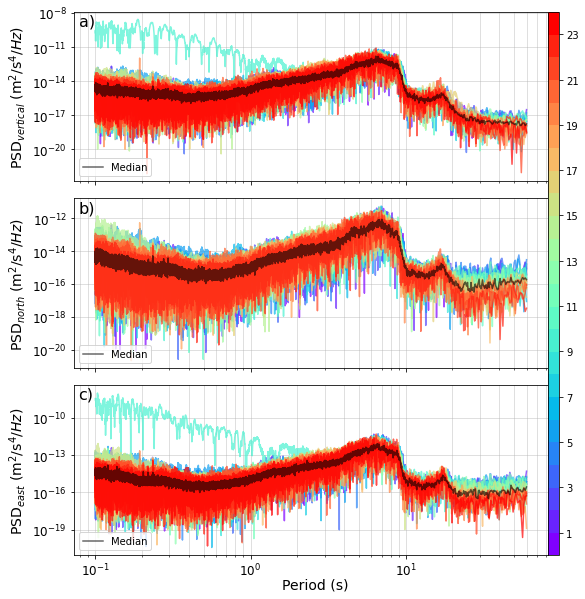


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221023.png ...

   -> Done

2022_PFO_Z_3600_20221024_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


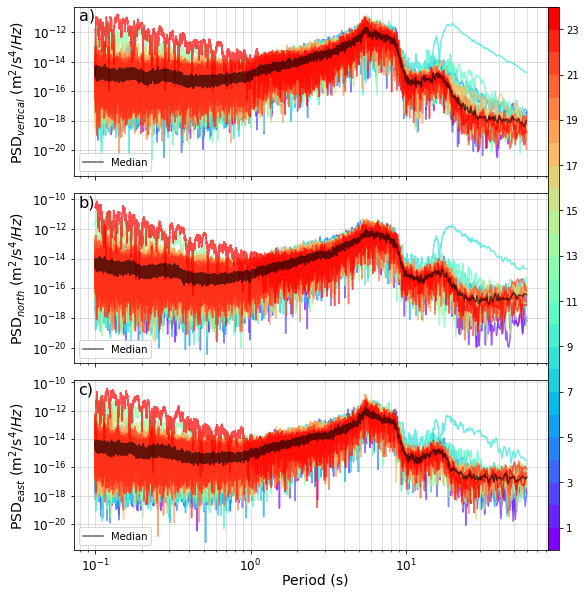


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221024.png ...

   -> Done

2022_PFO_Z_3600_20221025_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


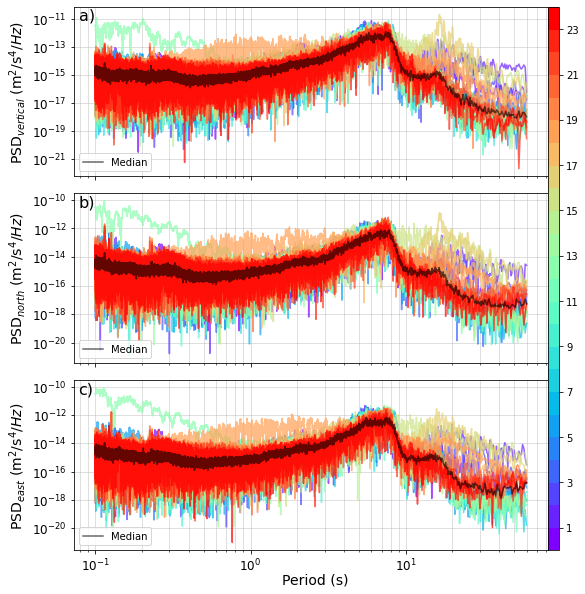


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221025.png ...

   -> Done

2022_PFO_Z_3600_20221026_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


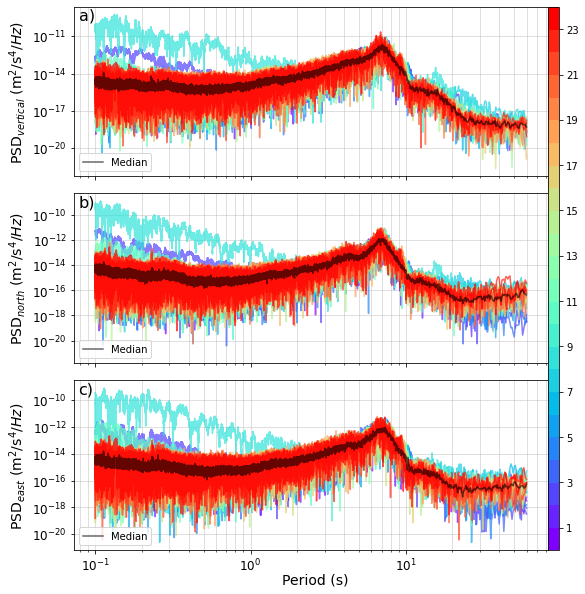


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221026.png ...

   -> Done

2022_PFO_Z_3600_20221027_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


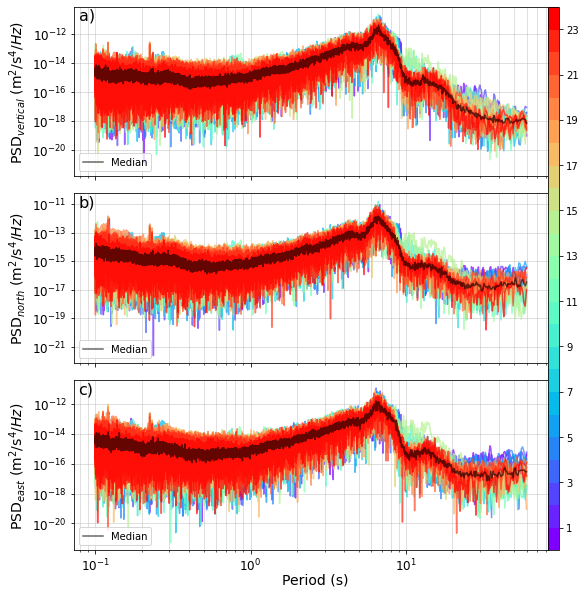


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221027.png ...

   -> Done

2022_PFO_Z_3600_20221028_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


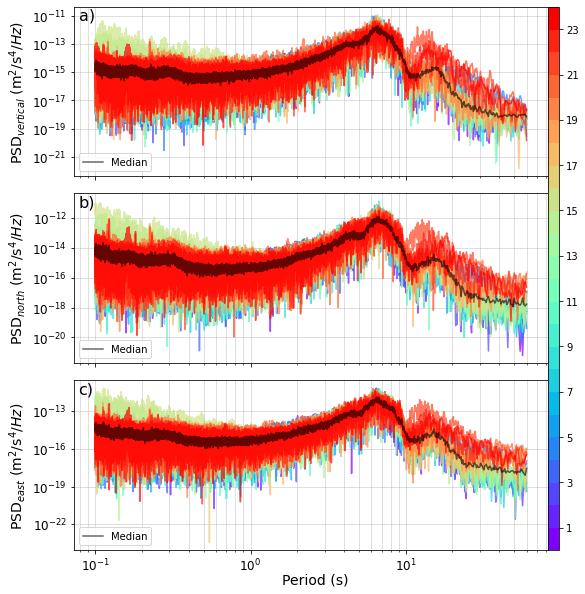


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221028.png ...

   -> Done

2022_PFO_Z_3600_20221029_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


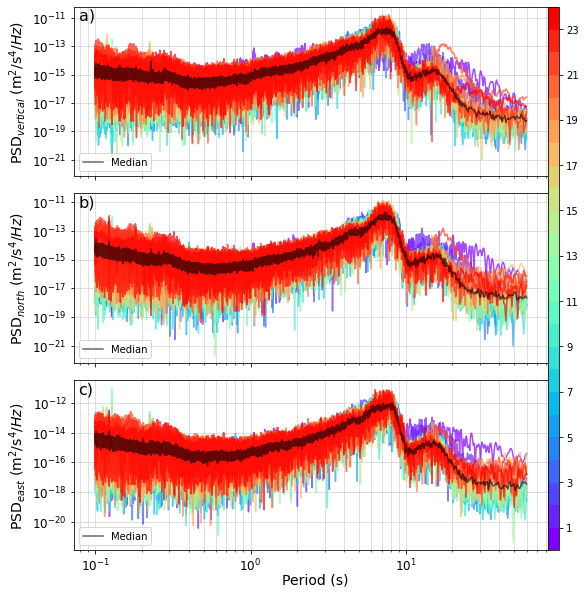


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221029.png ...

   -> Done

2022_PFO_Z_3600_20221030_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


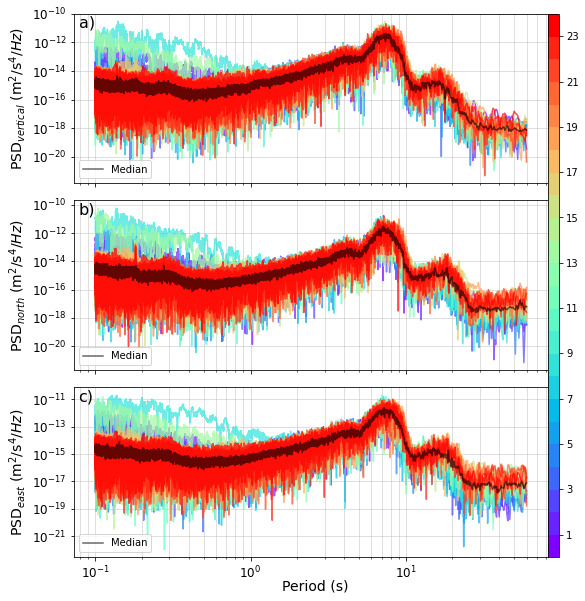


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221030.png ...

   -> Done

2022_PFO_Z_3600_20221031_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


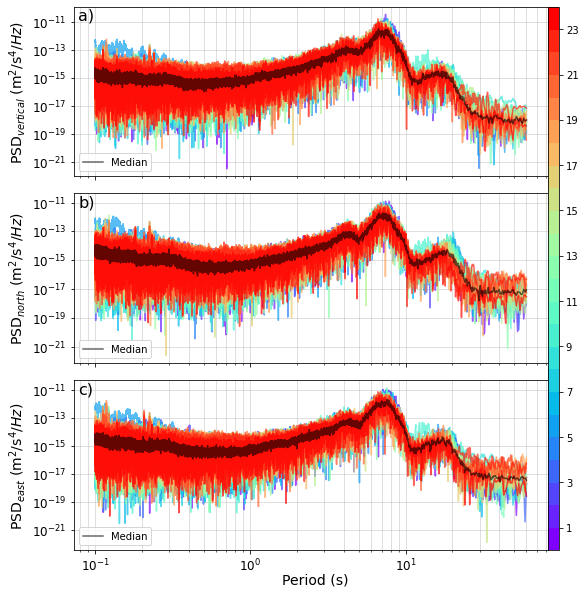


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221031.png ...

   -> Done

2022_PFO_Z_3600_20221101_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


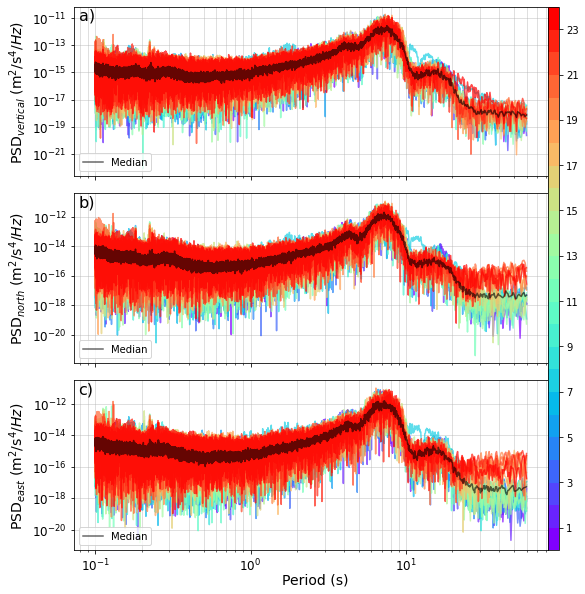


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221101.png ...

   -> Done

2022_PFO_Z_3600_20221102_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


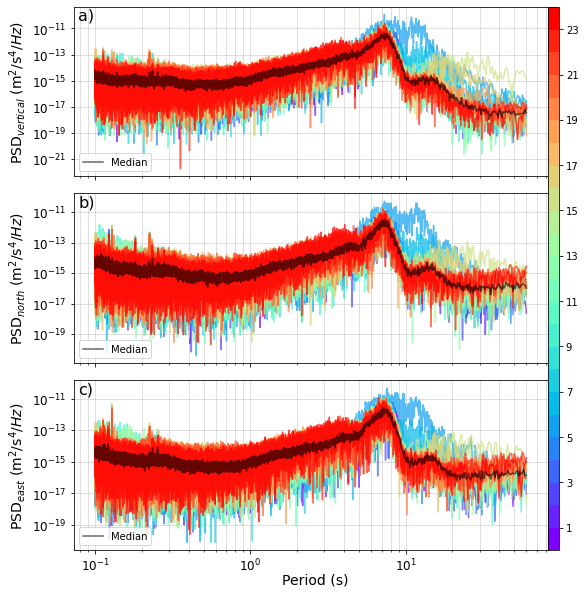


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221102.png ...

   -> Done

2022_PFO_Z_3600_20221103_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


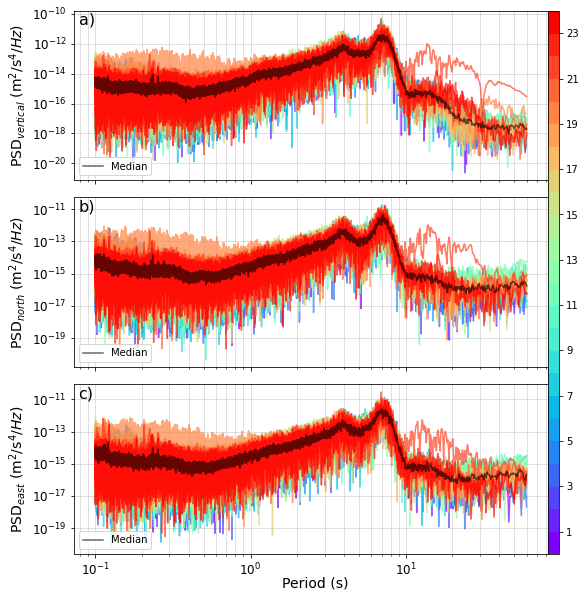


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221103.png ...

   -> Done

2022_PFO_Z_3600_20221104_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


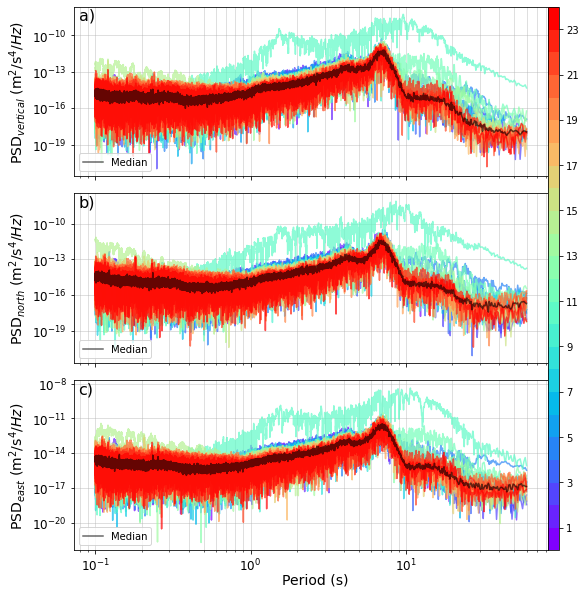


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221104.png ...

   -> Done

2022_PFO_Z_3600_20221105_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


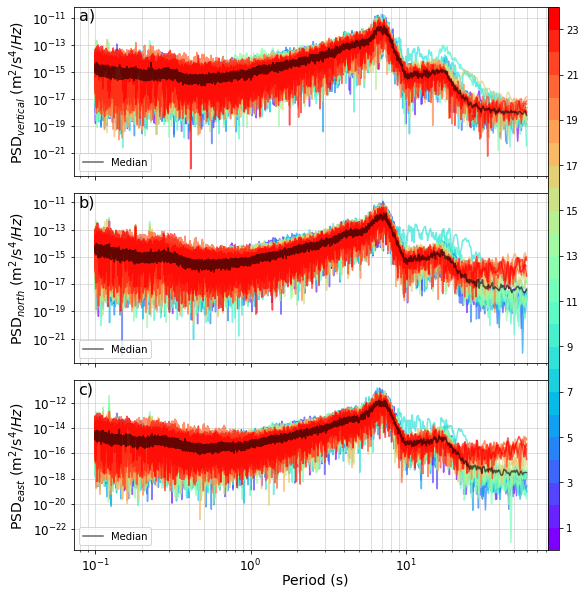


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221105.png ...

   -> Done

2022_PFO_Z_3600_20221106_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


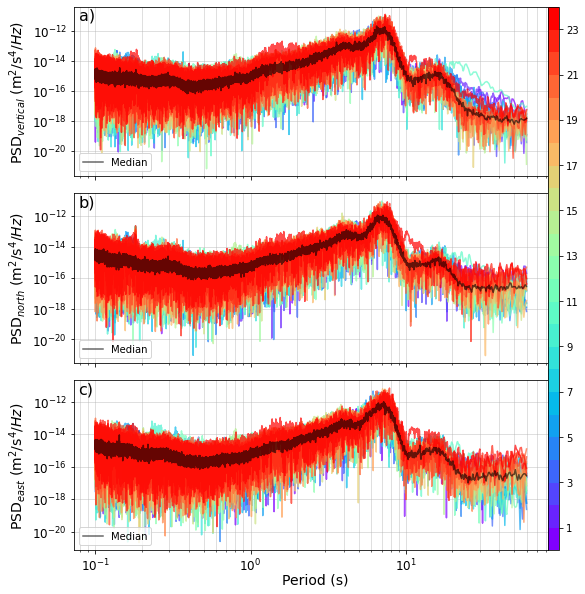


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221106.png ...

   -> Done

2022_PFO_Z_3600_20221107_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


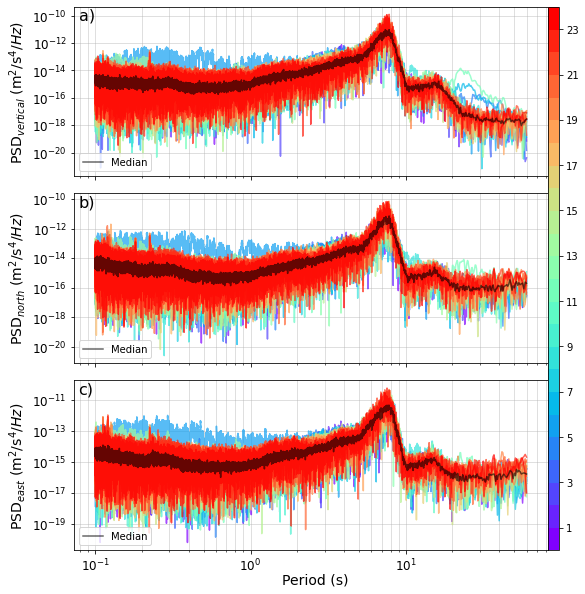


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221107.png ...

   -> Done

2022_PFO_Z_3600_20221108_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


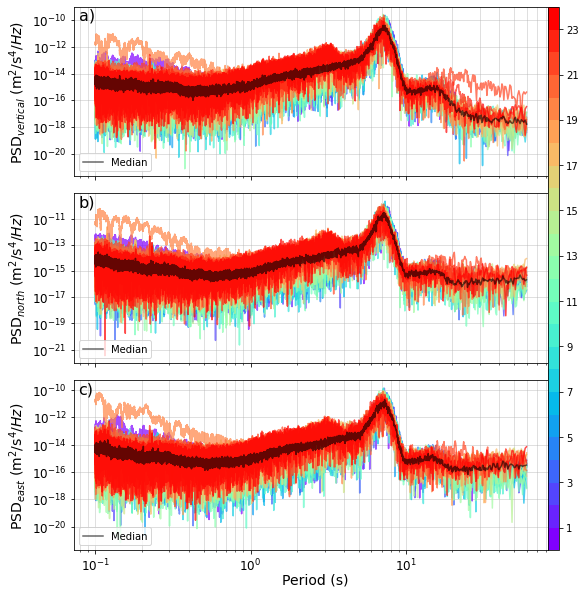


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221108.png ...

   -> Done

2022_PFO_Z_3600_20221109_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


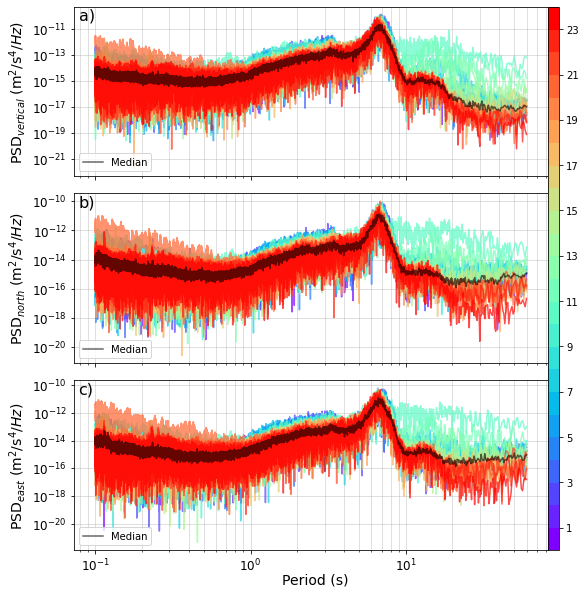


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221109.png ...

   -> Done

2022_PFO_Z_3600_20221110_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


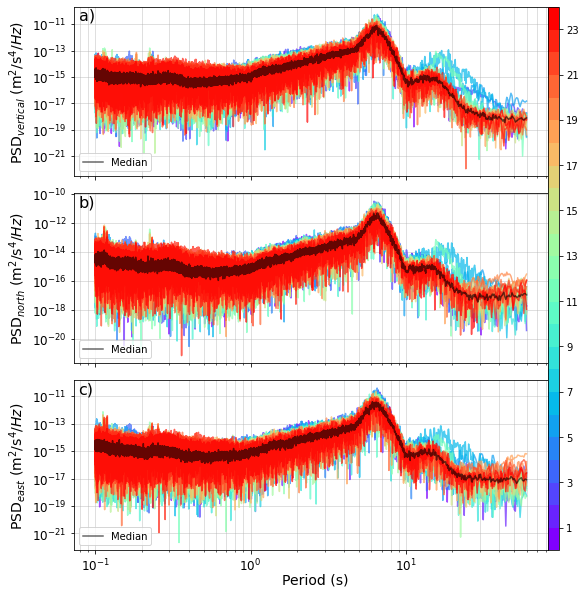


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221110.png ...

   -> Done

2022_PFO_Z_3600_20221111_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


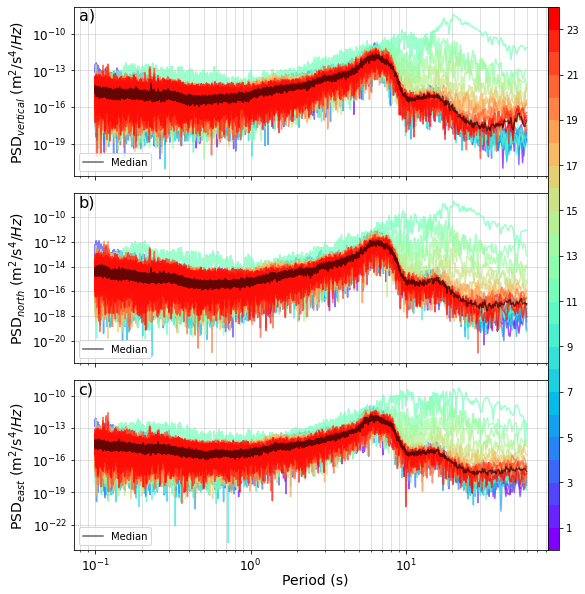


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221111.png ...

   -> Done

2022_PFO_Z_3600_20221112_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


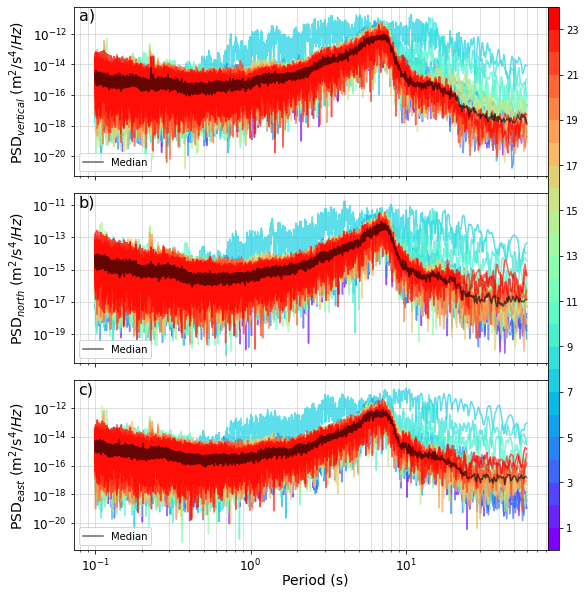


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221112.png ...

   -> Done

2022_PFO_Z_3600_20221113_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


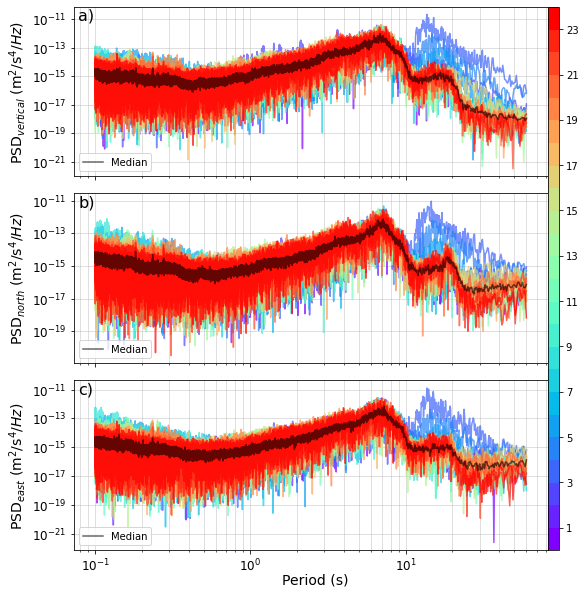


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221113.png ...

   -> Done

2022_PFO_Z_3600_20221114_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


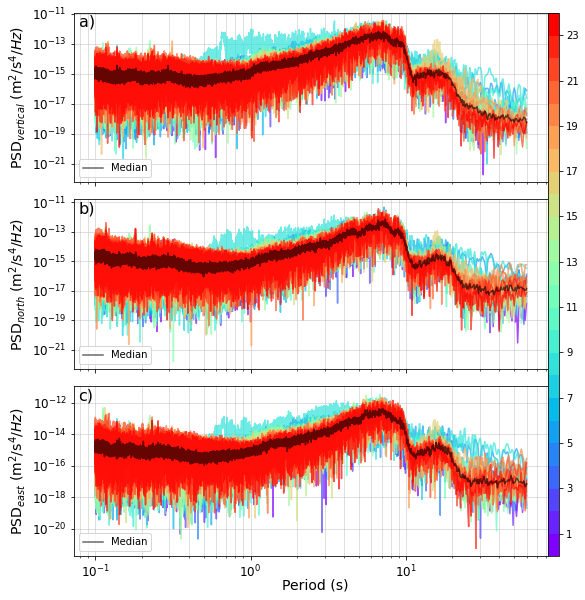


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221114.png ...

   -> Done

2022_PFO_Z_3600_20221115_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


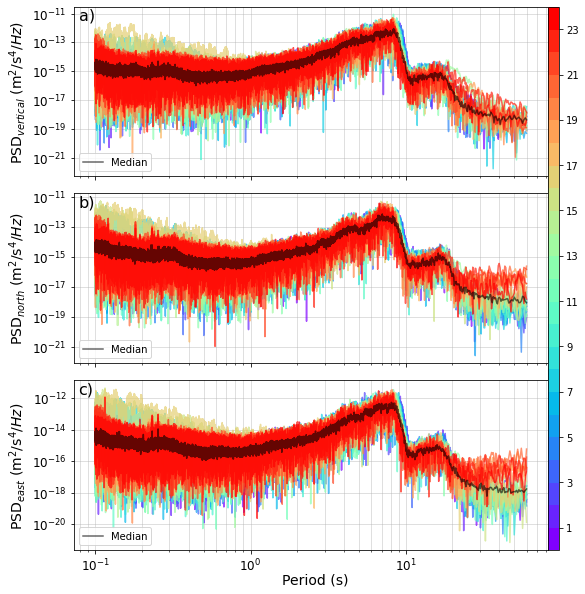


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221115.png ...

   -> Done

2022_PFO_Z_3600_20221116_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


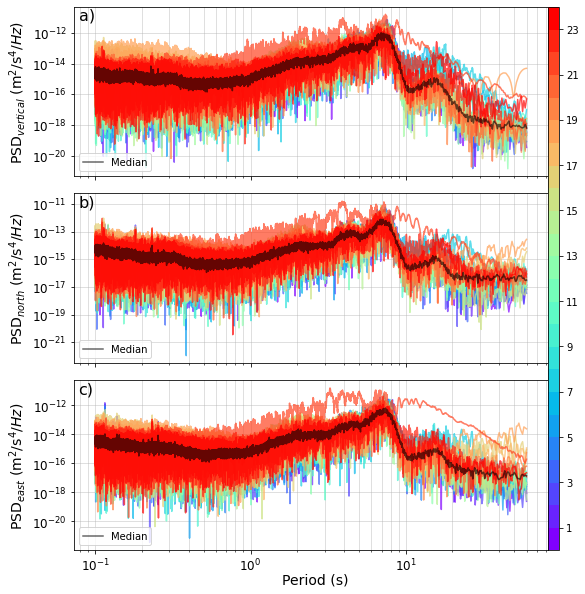


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221116.png ...

   -> Done

2022_PFO_Z_3600_20221117_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


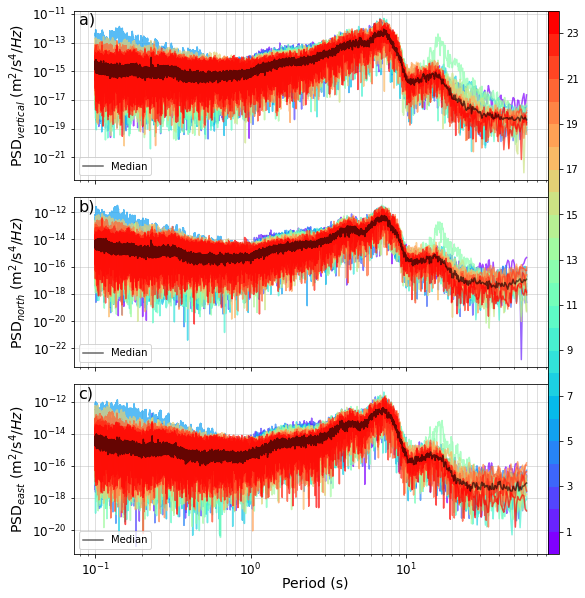


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221117.png ...

   -> Done

2022_PFO_Z_3600_20221118_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


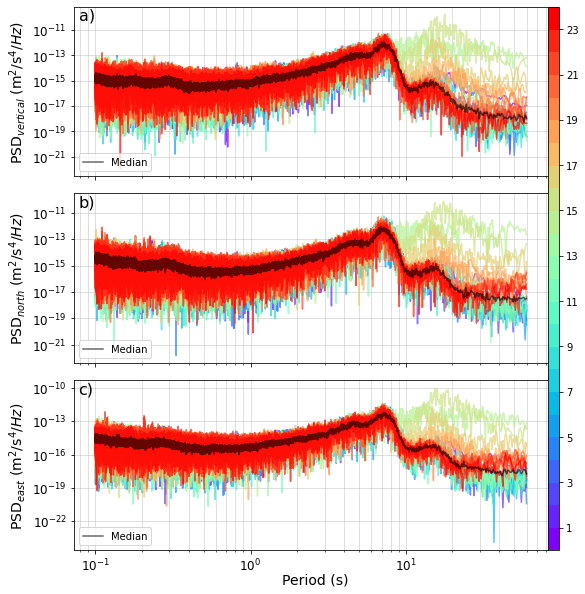


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221118.png ...

   -> Done

2022_PFO_Z_3600_20221119_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


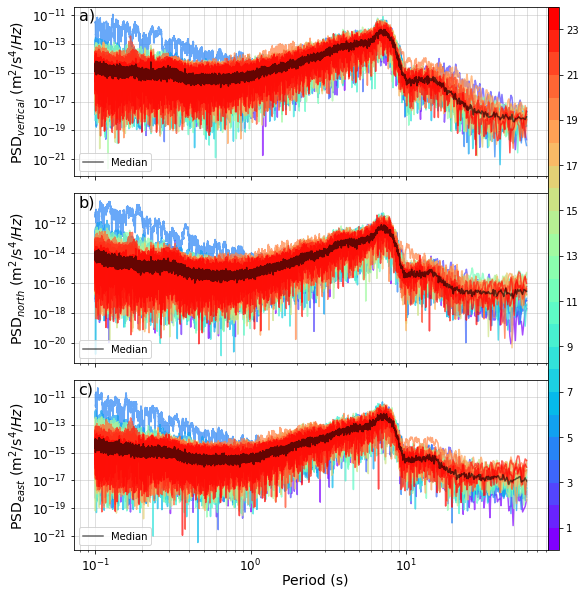


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221119.png ...

   -> Done

2022_PFO_Z_3600_20221120_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


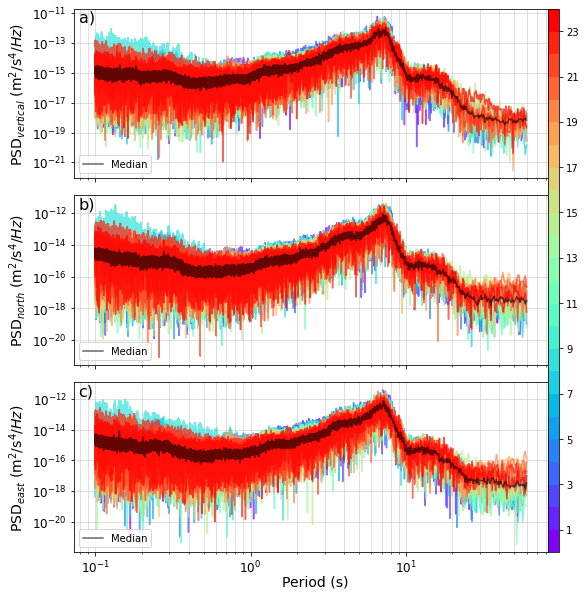


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221120.png ...

   -> Done

2022_PFO_Z_3600_20221121_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


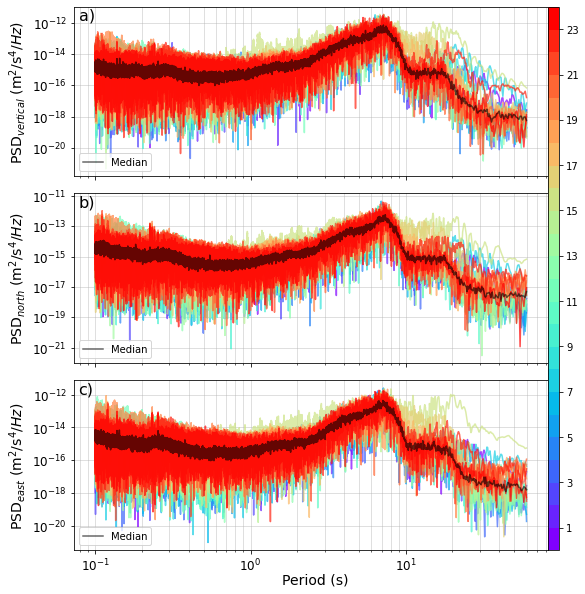


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221121.png ...

   -> Done

2022_PFO_Z_3600_20221122_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


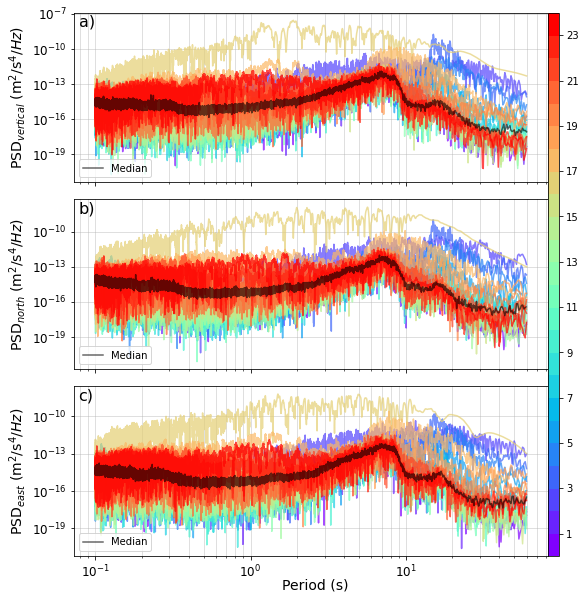


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221122.png ...

   -> Done

2022_PFO_Z_3600_20221123_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


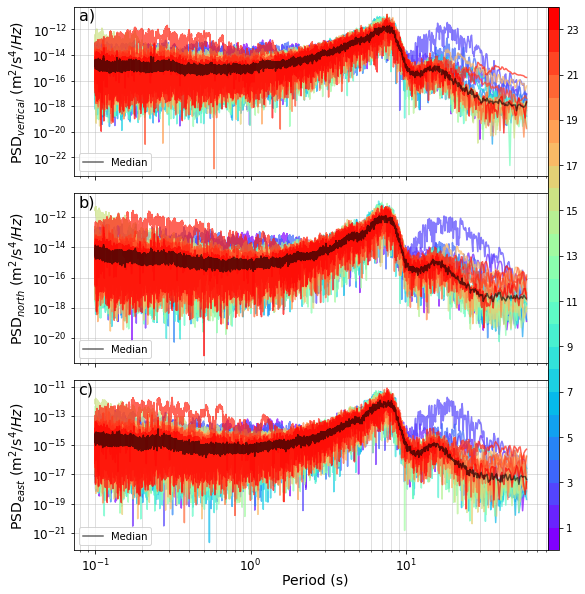


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221123.png ...

   -> Done

2022_PFO_Z_3600_20221124_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


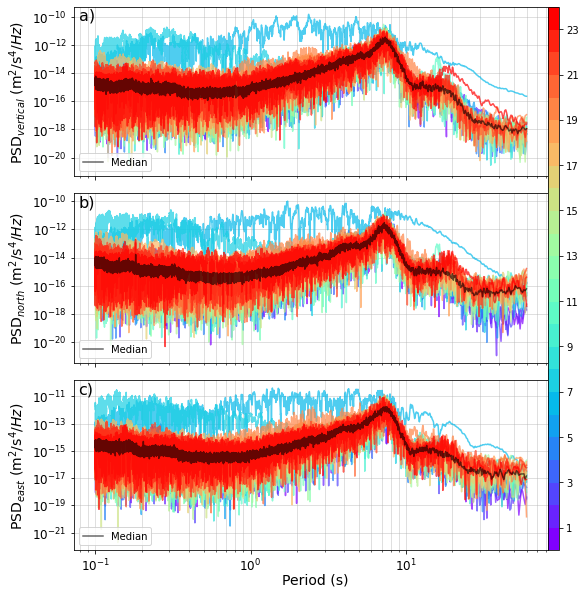


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221124.png ...

   -> Done

2022_PFO_Z_3600_20221125_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


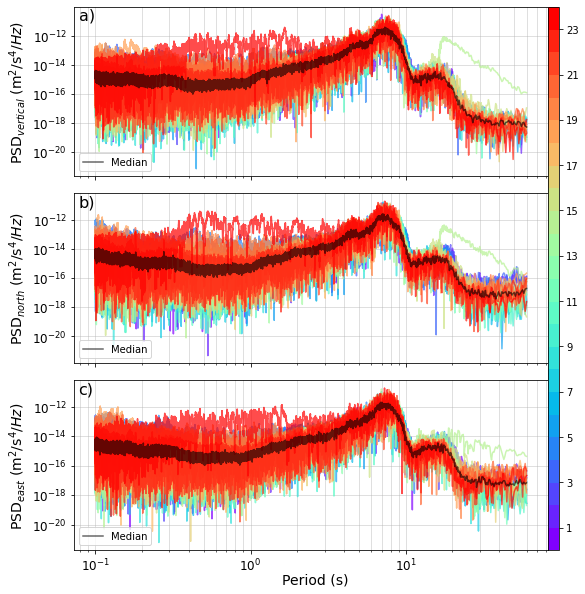


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221125.png ...

   -> Done

2022_PFO_Z_3600_20221126_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


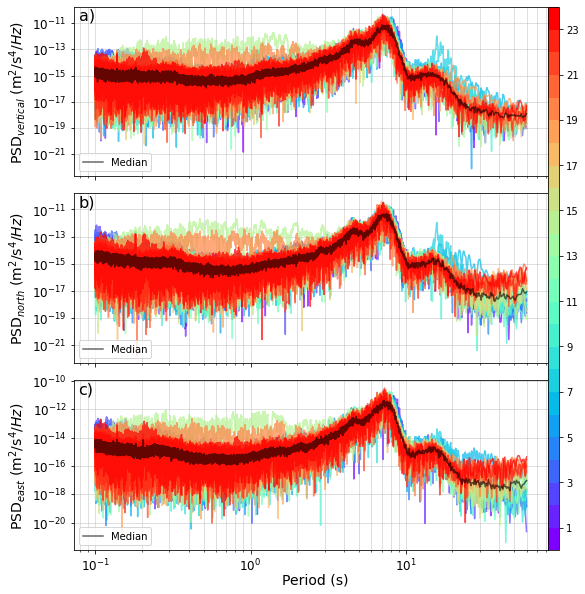


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221126.png ...

   -> Done

2022_PFO_Z_3600_20221127_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


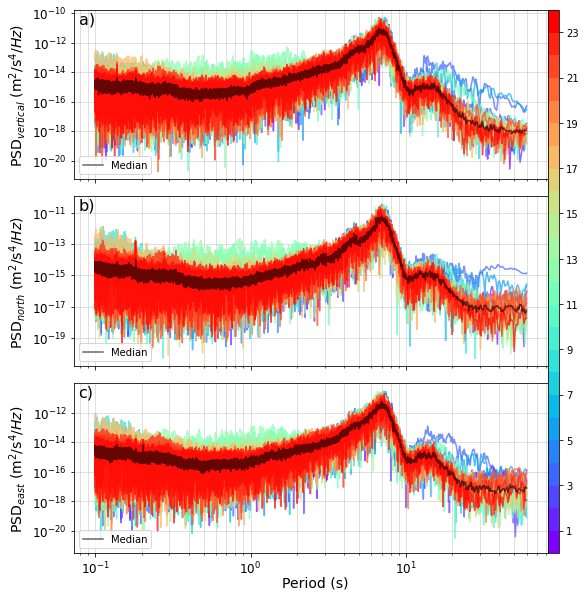


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221127.png ...

   -> Done

2022_PFO_Z_3600_20221128_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


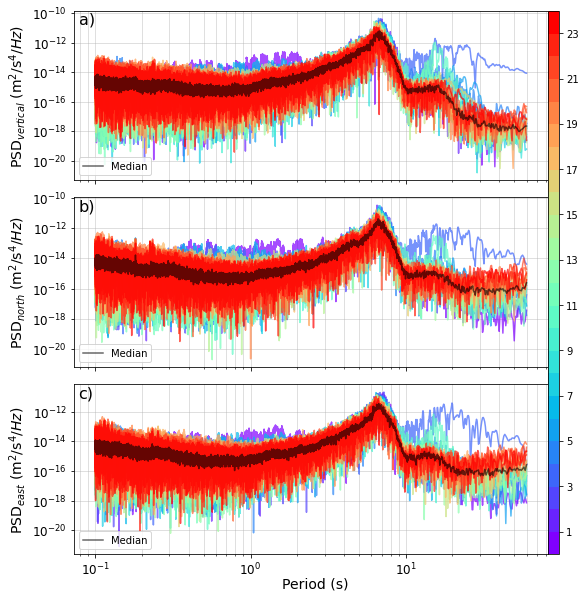


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221128.png ...

   -> Done

2022_PFO_Z_3600_20221129_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


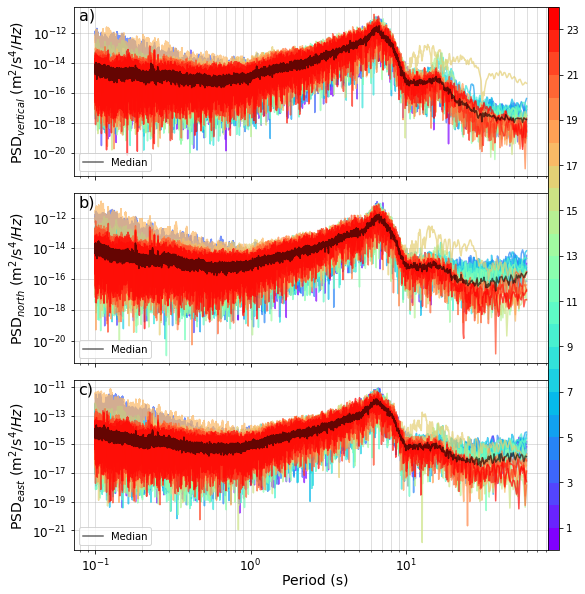


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221129.png ...

   -> Done

2022_PFO_Z_3600_20221130_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


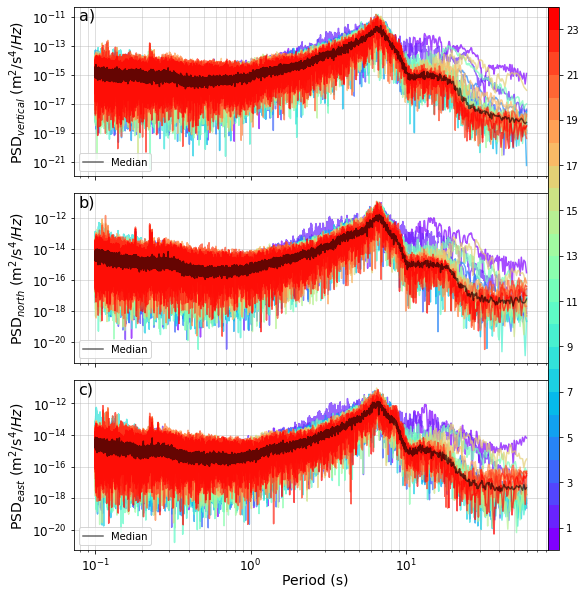


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221130.png ...

   -> Done

2022_PFO_Z_3600_20221201_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


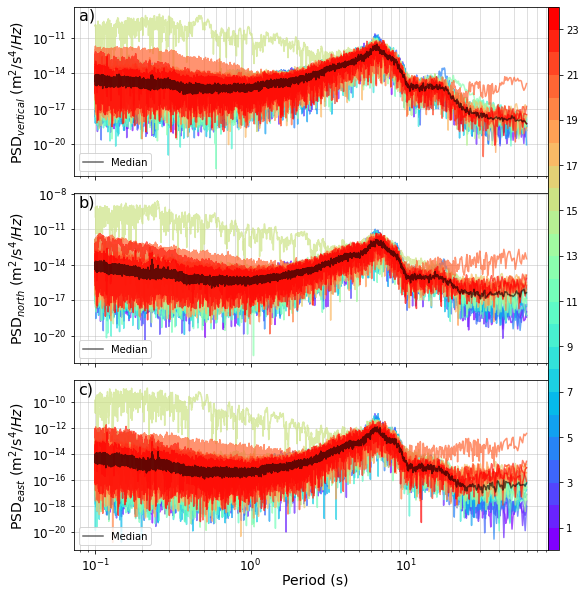


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221201.png ...

   -> Done

2022_PFO_Z_3600_20221202_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


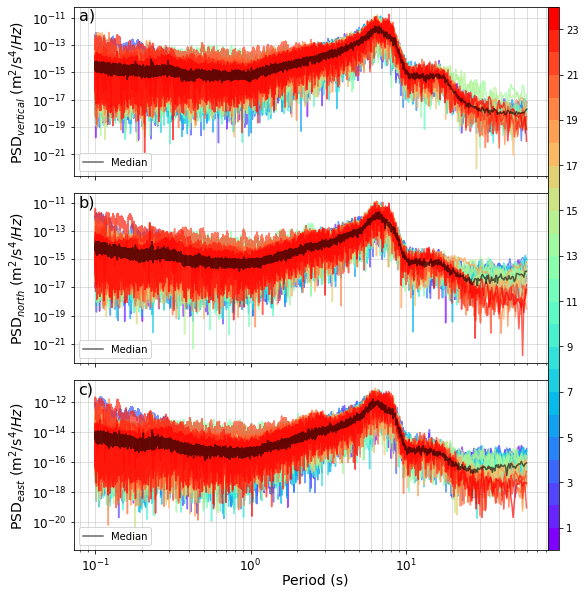


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221202.png ...

   -> Done

2022_PFO_Z_3600_20221203_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


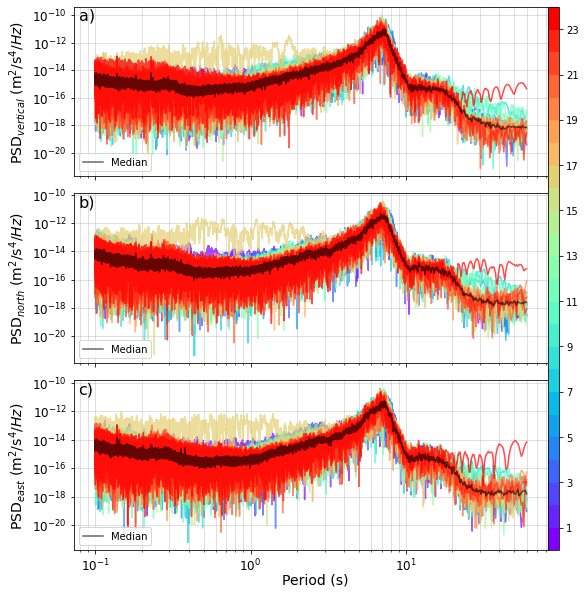


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221203.png ...

   -> Done

2022_PFO_Z_3600_20221204_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


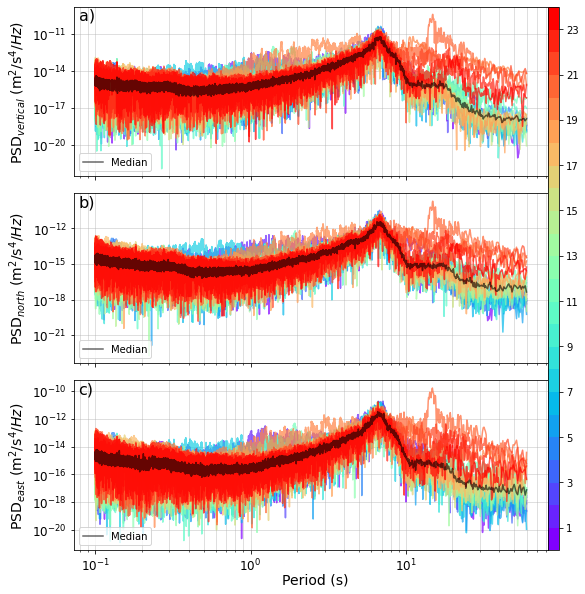


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221204.png ...

   -> Done

2022_PFO_Z_3600_20221205_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


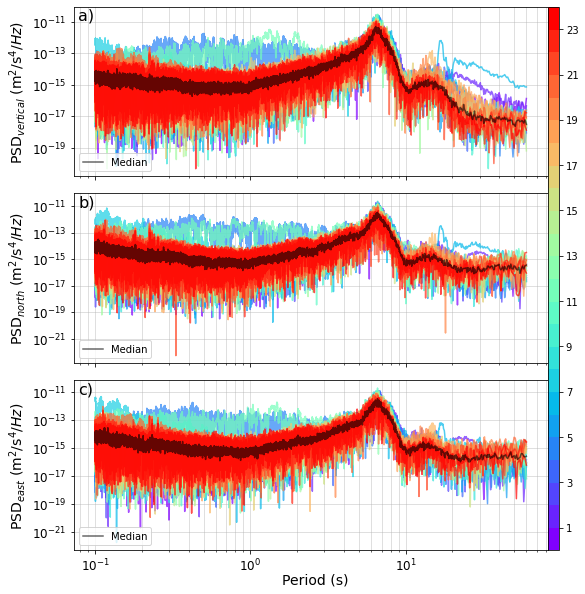


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221205.png ...

   -> Done

2022_PFO_Z_3600_20221206_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


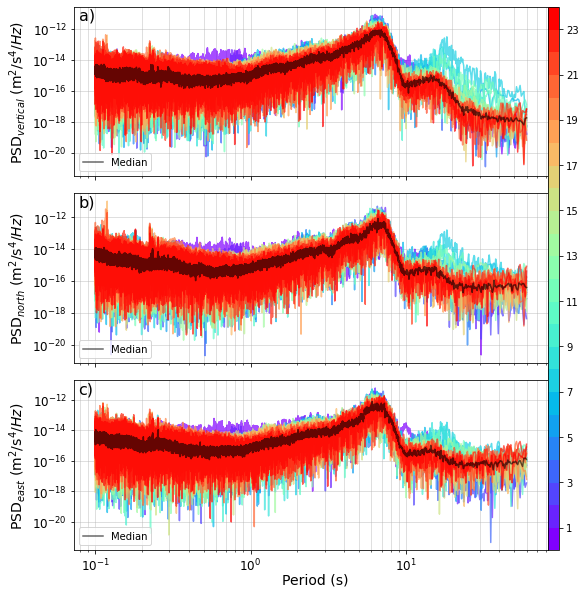


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221206.png ...

   -> Done

2022_PFO_Z_3600_20221207_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


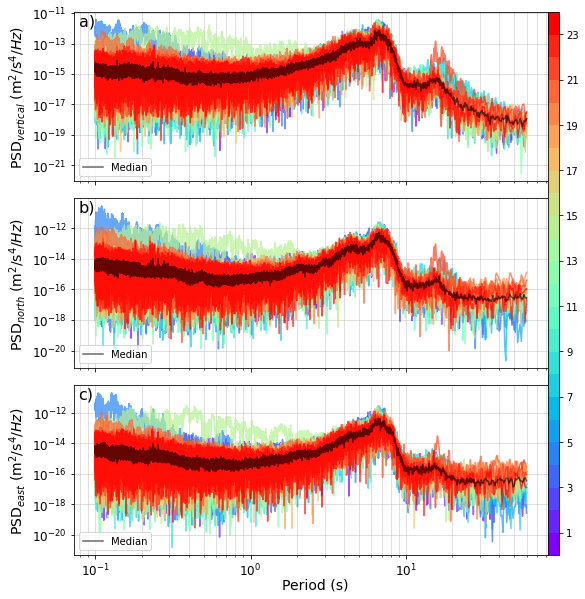


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221207.png ...

   -> Done

2022_PFO_Z_3600_20221208_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


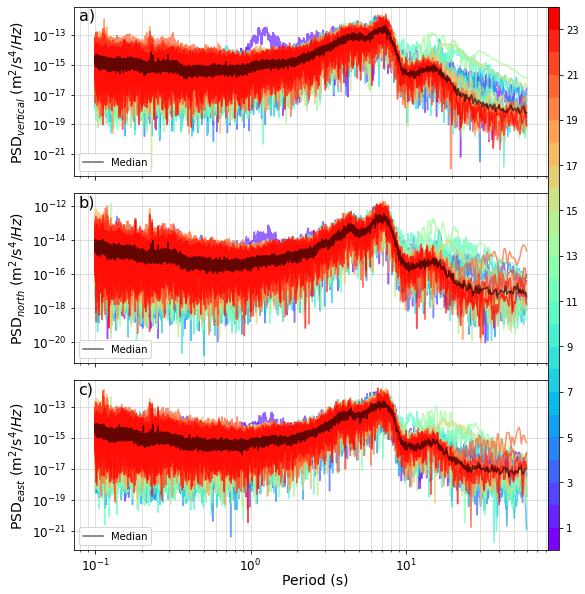


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221208.png ...

   -> Done

2022_PFO_Z_3600_20221209_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


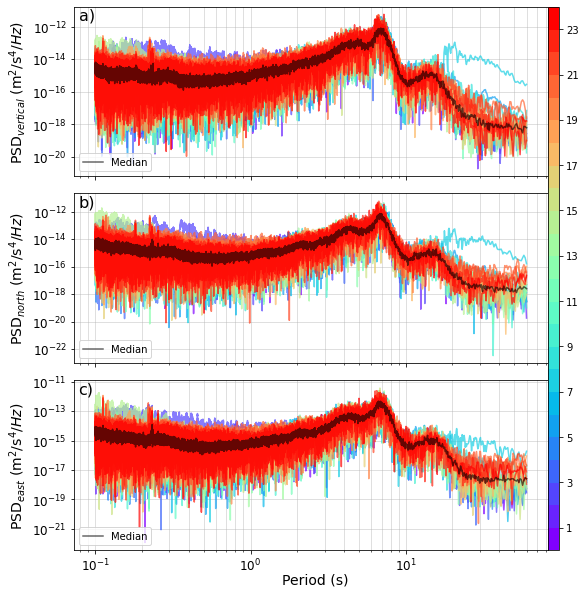


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221209.png ...

   -> Done

2022_PFO_Z_3600_20221210_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


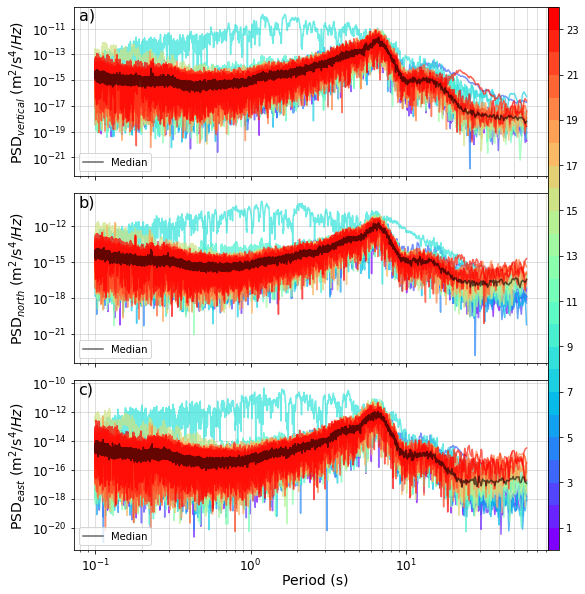


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221210.png ...

   -> Done

2022_PFO_Z_3600_20221211_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


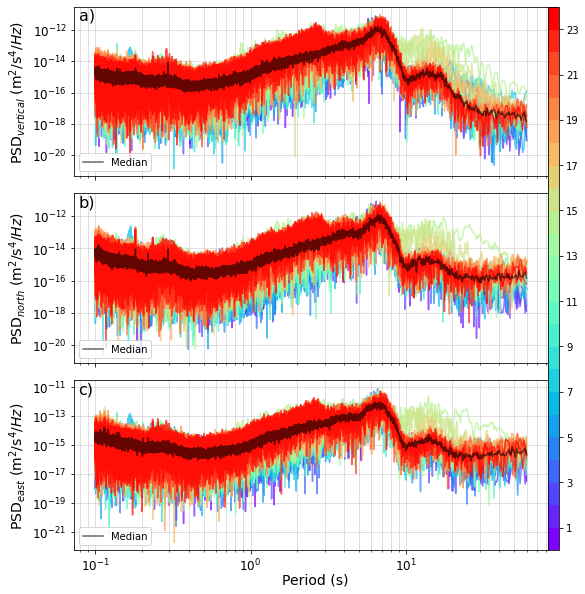


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221211.png ...

   -> Done

2022_PFO_Z_3600_20221212_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


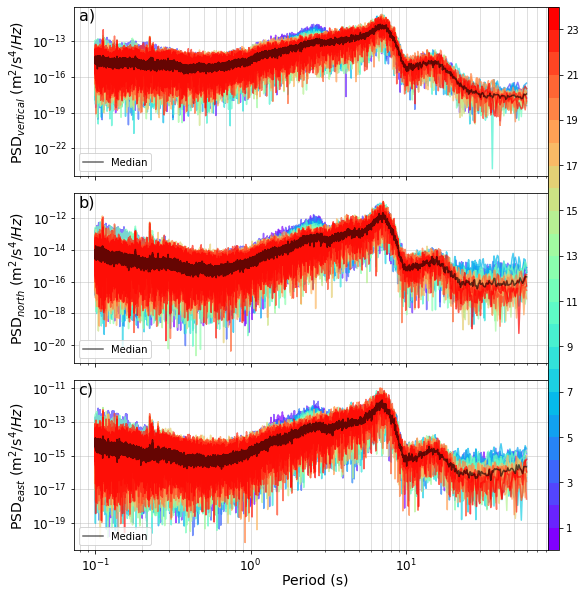


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221212.png ...

   -> Done

2022_PFO_Z_3600_20221213_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


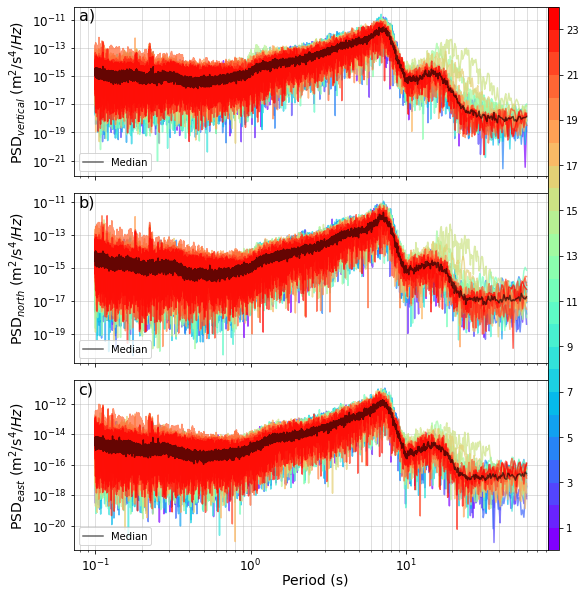


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221213.png ...

   -> Done

2022_PFO_Z_3600_20221214_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


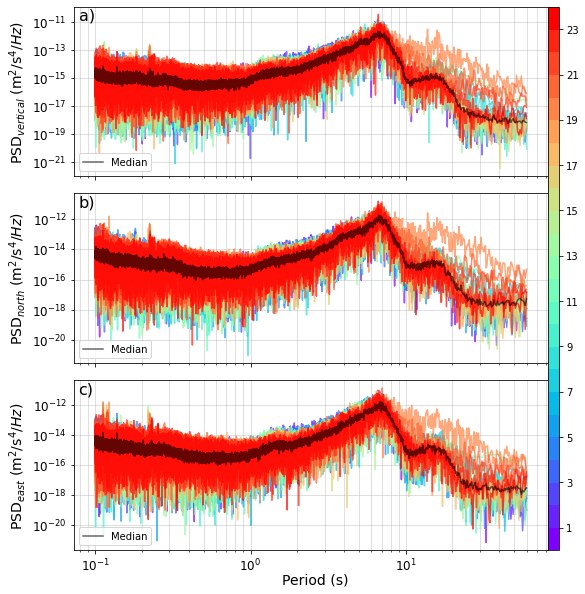


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221214.png ...

   -> Done

2022_PFO_Z_3600_20221215_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


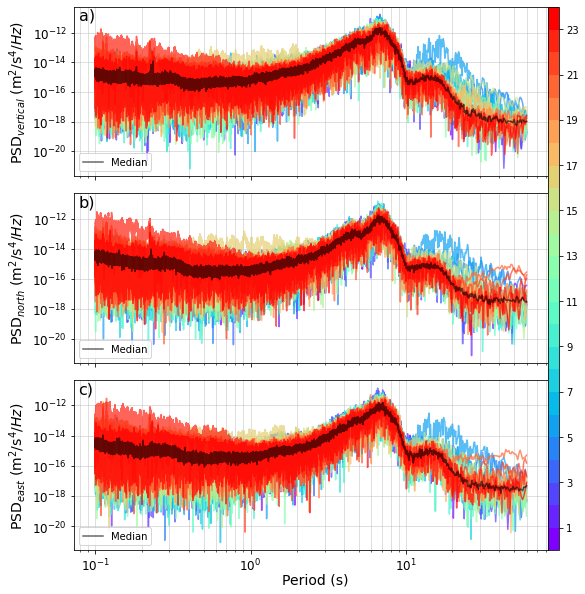


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221215.png ...

   -> Done

2022_PFO_Z_3600_20221216_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


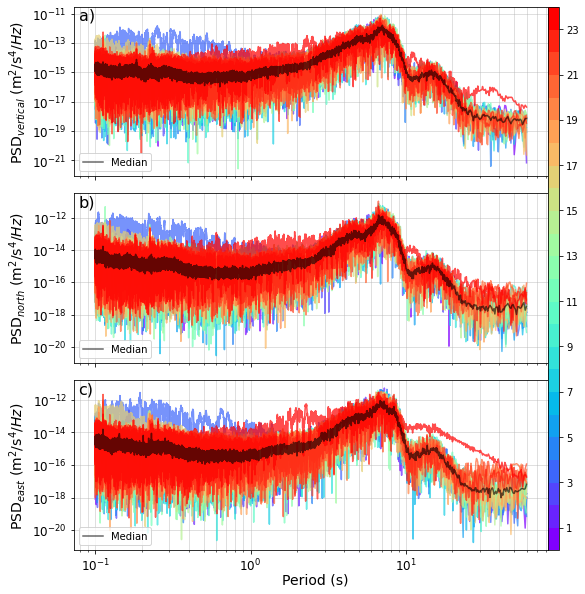


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221216.png ...

   -> Done

2022_PFO_Z_3600_20221217_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


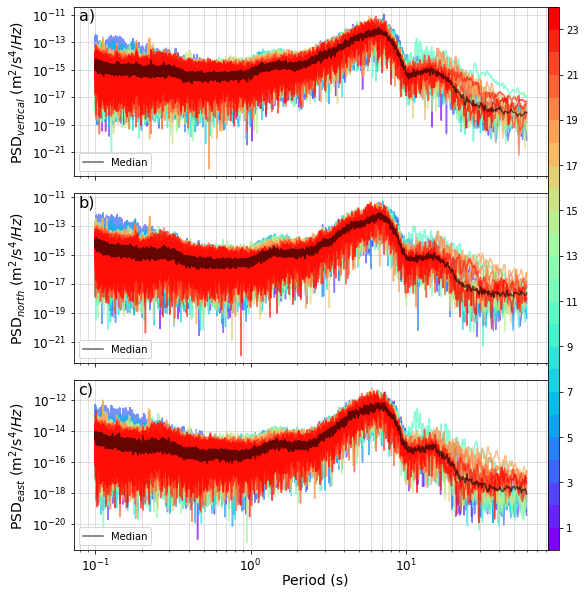


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221217.png ...

   -> Done

2022_PFO_Z_3600_20221218_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


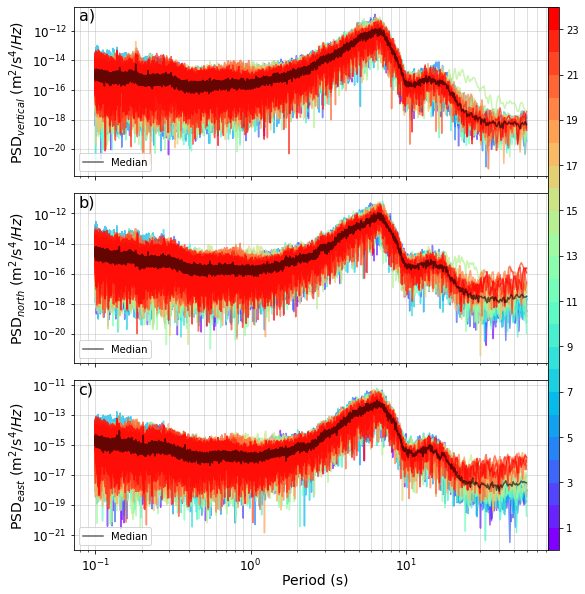


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221218.png ...

   -> Done

2022_PFO_Z_3600_20221219_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


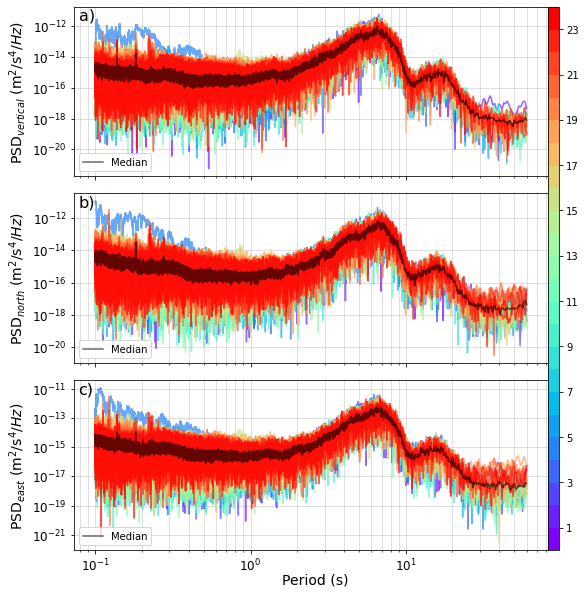


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221219.png ...

   -> Done

2022_PFO_Z_3600_20221220_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


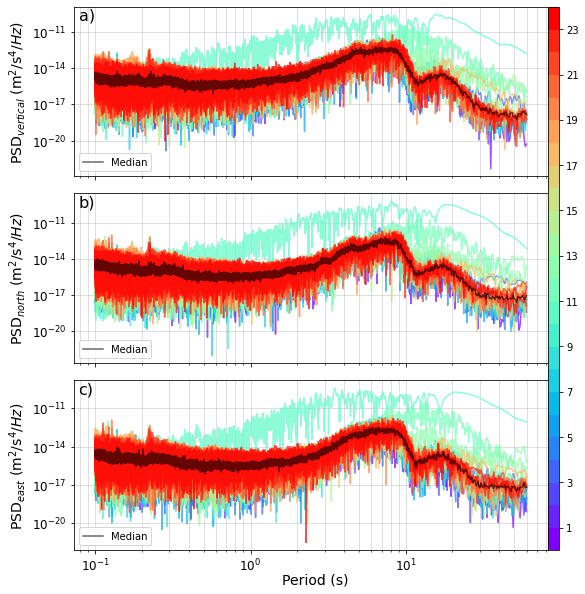


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221220.png ...

   -> Done

2022_PFO_Z_3600_20221221_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


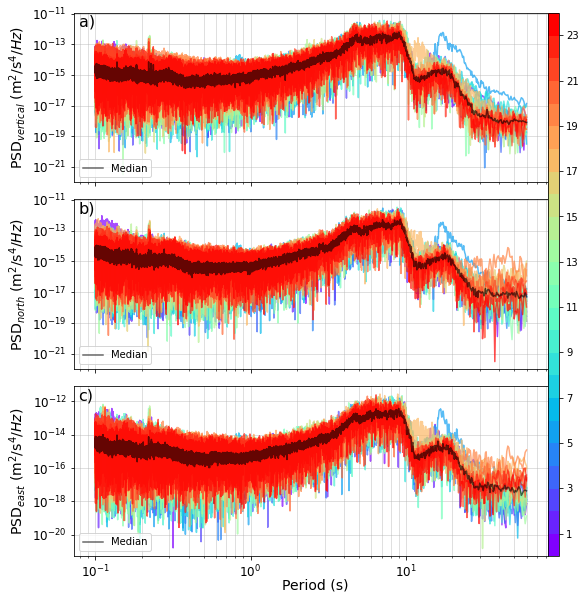


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221221.png ...

   -> Done

2022_PFO_Z_3600_20221222_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


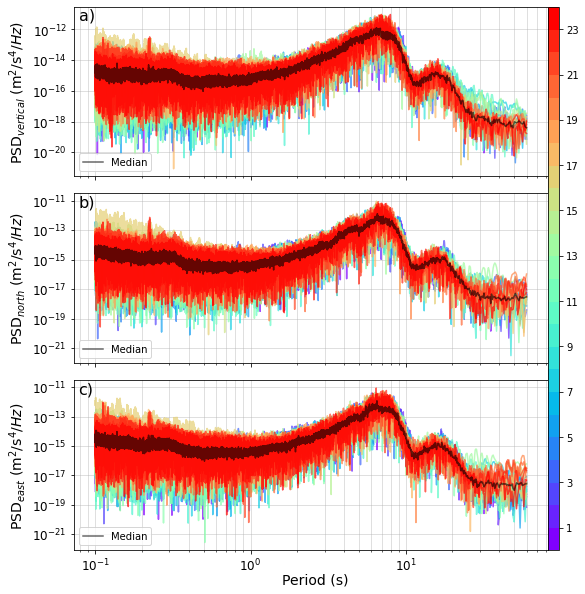


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221222.png ...

   -> Done

2022_PFO_Z_3600_20221223_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


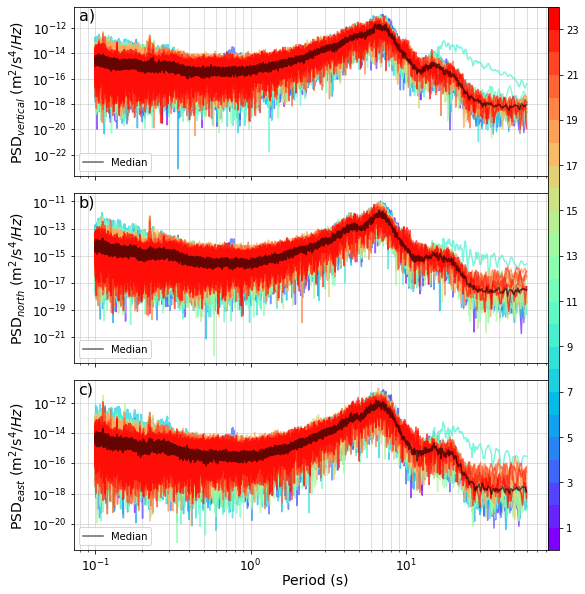


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221223.png ...

   -> Done

2022_PFO_Z_3600_20221224_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


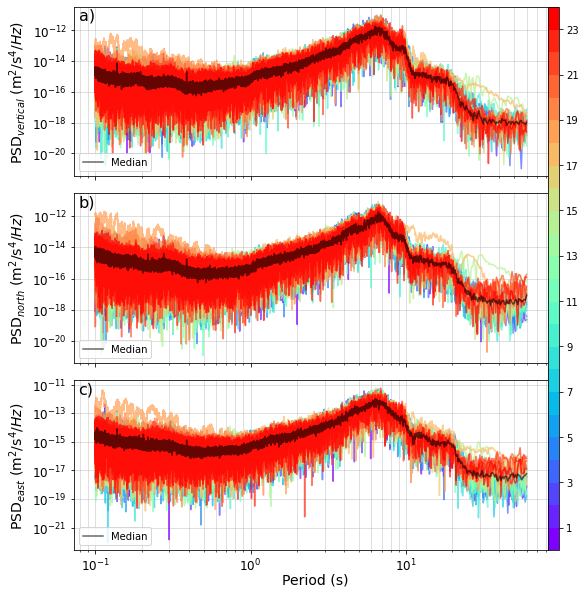


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221224.png ...

   -> Done

2022_PFO_Z_3600_20221225_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


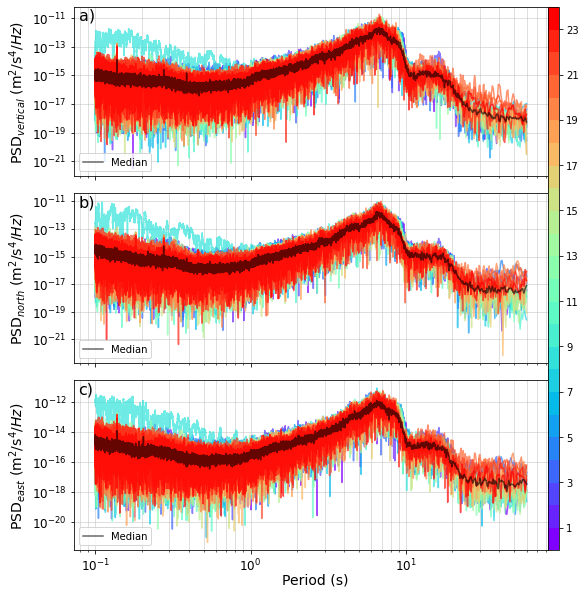


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221225.png ...

   -> Done

2022_PFO_Z_3600_20221226_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


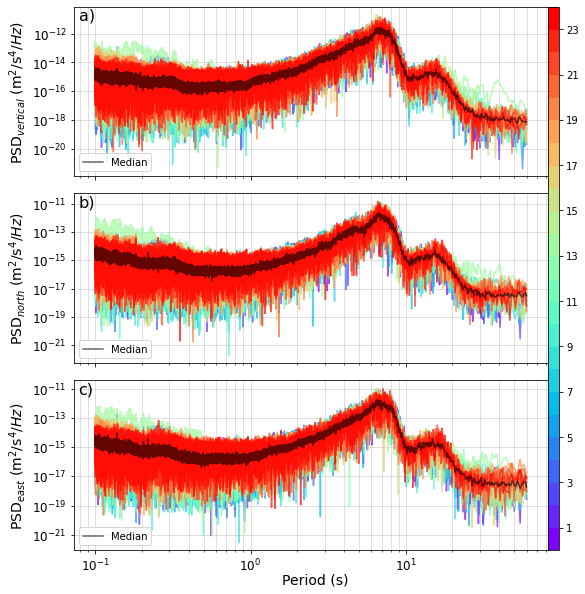


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221226.png ...

   -> Done

2022_PFO_Z_3600_20221227_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


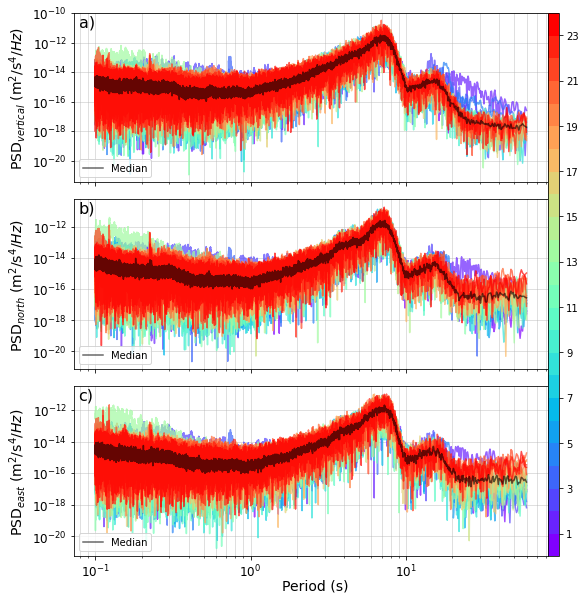


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221227.png ...

   -> Done

2022_PFO_Z_3600_20221228_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


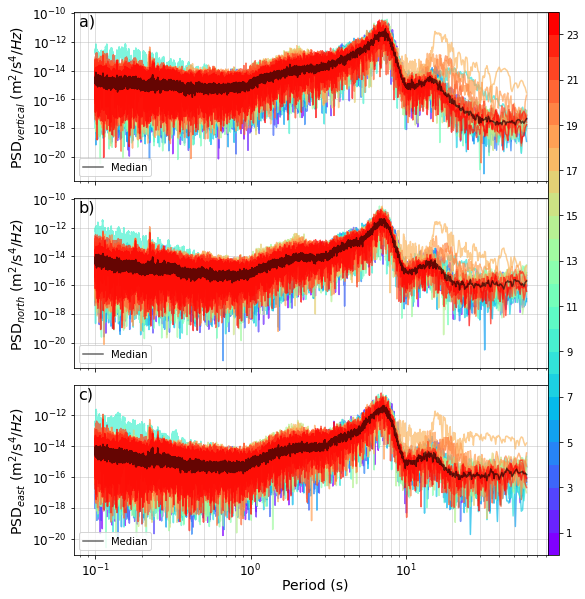


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221228.png ...

   -> Done

2022_PFO_Z_3600_20221229_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


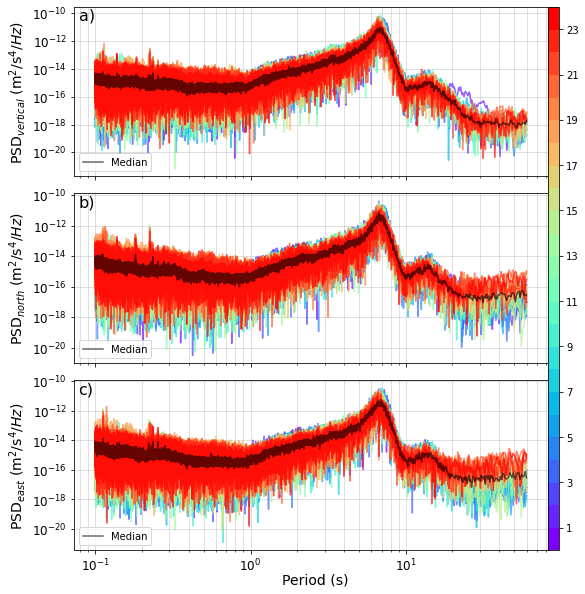


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221229.png ...

   -> Done

2022_PFO_Z_3600_20221230_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain


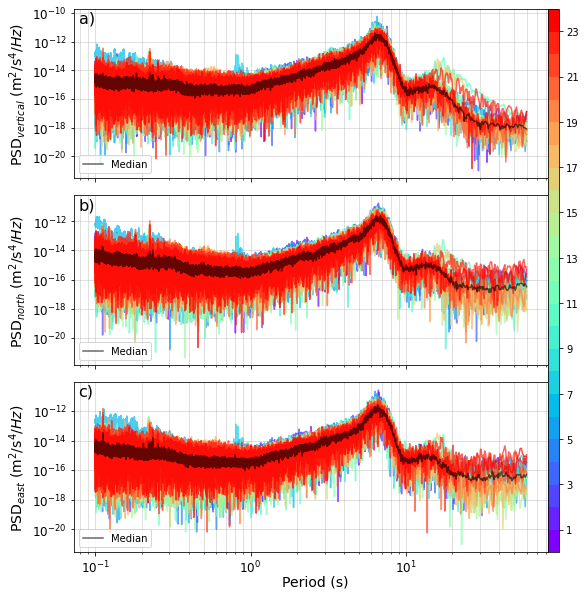


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221230.png ...

   -> Done

2022_PFO_Z_3600_20221231_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain


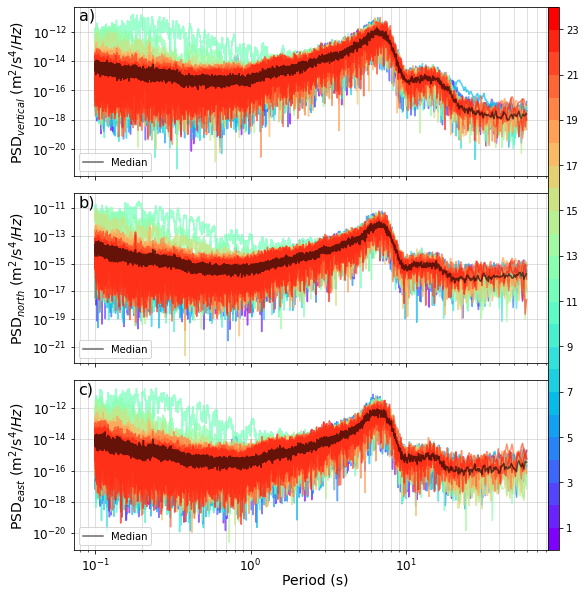


   -> saving /home/andbro/kilauea-data//BSPF/figures_colorlines/PFO_20221231.png ...

   -> Done



In [16]:
config['files'] = [file for file in os.listdir(config['inpath']) if "hourly" in file]
config['files'].sort()


psds_medians_out, times_out = [],[]

for file in config['files']:

    print(file)
    
    day = file.split("_")[-2]
    
    config['outpath_figname'] = config['station']+"_"+day
    
    if os.path.isfile(config['outpath_figures']+config['outpath_figname']):
        continue

    ff_Z = pickle.load(open(f"{config['inpath'].replace('Z','Z')}{config['inname'].replace('Z','Z')}_frequency_axis.pkl", 'rb'))
    ff_N = pickle.load(open(f"{config['inpath'].replace('Z','N')}{config['inname'].replace('Z','N')}_frequency_axis.pkl", 'rb'))
    ff_E = pickle.load(open(f"{config['inpath'].replace('Z','E')}{config['inname'].replace('Z','E')}_frequency_axis.pkl", 'rb'))
        
    ADR_Z = __load_data_file(config['inpath'].replace("Z","Z"), file.replace("Z","Z"))        
    ADR_N = __load_data_file(config['inpath'].replace("Z","N"), file.replace("Z","N"))        
    ADR_E = __load_data_file(config['inpath'].replace("Z","E"), file.replace("Z","E"))        

    ADR_N, ff_N = __cut_frequencies_array(ADR_N, ff_N, config['frequency_limits'][0], config['frequency_limits'][1])
    ADR_E, ff_E = __cut_frequencies_array(ADR_E, ff_E, config['frequency_limits'][0], config['frequency_limits'][1])
    ADR_Z, ff_Z = __cut_frequencies_array(ADR_Z, ff_Z, config['frequency_limits'][0], config['frequency_limits'][1])
    
    ADR_N, rejected_N = __remove_noisy_psds(ADR_N, threshold_mean=config['thres'])
    ADR_E, rejected_E = __remove_noisy_psds(ADR_E, threshold_mean=config['thres'])
    ADR_Z, rejected_Z = __remove_noisy_psds(ADR_Z, threshold_mean=config['thres'])
    
    fig = __makeplot_colorlines_overview(config, 
                                         [ff_Z, ff_N, ff_E], 
                                         [ADR_Z, ADR_N, ADR_E], 
                                         [rejected_Z, rejected_N, rejected_E],
                                         day)
    

#     fig.savefig(config['outpath_figures']+config['outpath_figname'], format="png", transparent=False)
    __savefig(fig, outpath=config['outpath_figures'], outname=config['outpath_figname'], mode="png", dpi=300)   


    ## output data
#     psds_medians_out.append(psds_median)
#     times_out.append(time)
    
# ## write output
# output = {"times": array(times_out).astype(int), "frequencies": array(ff), "psds_medians": array(psds_medians_out)}

# with open(f"{config['inpath']}{config['inname']}_psds_filtered_medians.pkl", 'wb') as file:
#     pickle.dump(output, file, protocol=pickle.HIGHEST_PROTOCOL)
